# TEAM 18 PHASE 1 NOTEBOOK
#### ALEX CARITE, MUHAMMAD JAWAID, PETER MORGAN & THOMAS WELSH
#### W261 MACHINE LEARNING AT SCALE - SUMMER 2022

#### Introduction
Accurately determining whether a departing flight will be delayed, with enough advance notice to mitigate the delay’s impact, is crucial for companies to survive and succeed in today’s competitive aviation industry. To meet the needs of our aviation logistics customers—airlines, shipping companies, aviation suppliers and passenger service companies—Team18 Associates has developed a forecasting tool that predicts, two hours ahead of the scheduled departure time, whether or not a given flight departing from a commercial U.S. airport will be delayed by more than 15 minutes.

### Step 1: Import Libraries and Data

In [0]:
from pyspark.sql.functions import col, when
from pyspark.sql.functions import *
import pyspark.sql.functions as F
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import datetime as dt
import re
from sklearn.model_selection import TimeSeriesSplit
!pip install -U airportsdata
import airportsdata
print("Welcome to the W261 final project - Team 18 in the house!")

/databricks/python/lib/python3.8/site-packages/scipy/__init__.py:138: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.23.1)
 warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion} is required for this version of "
Collecting airportsdata
 Downloading airportsdata-20220625-py3-none-any.whl (1.0 MB)
▎ | 10 kB 30.0 MB/s eta 0:00:01 |▋ | 20 kB 36.4 MB/s eta 0:00:01 |█ | 30 kB 21.8 MB/s eta 0:00:01 |█▎ | 40 kB 12.4 MB/s eta 0:00:01 |█▋ | 51 kB 11.4 MB/s eta 0:00:01 |██ | 61 kB 13.4 MB/s eta 0:00:01 |██▎ | 71 kB 13.1 MB/s eta 0:00:01 |██▋ | 81 kB 12.8 MB/s eta 0:00:01 |███ | 92 kB 14.2 MB/s eta 0:00:01 |███▎ | 102 kB 12.6 MB/s eta 0:00:01 |███▋ | 112 kB 12.6 MB/s eta 0:00:01 |███▉ | 122 kB 12.6 MB/s eta 0:00:01 |████▏ | 133 kB 12.6 MB/s eta 0:00:01 |████▌ | 143 kB 12.6 MB/s eta 0:00:01 |████▉ | 153 kB 12.6 MB/s eta 0:00:01 |█████▏ | 163 kB 12.6 MB/s eta 0:00:01 |█████▌ | 174 kB 12.6 MB/s eta 0:00:01 |█████▉ | 184 kB 12.6 MB/s eta 0:00:01 |██████▏ | 194 kB 12.6 MB/s eta 0:00:01 |██████▌ | 204 kB 12.6 MB/s eta 0:00:01 |██████▉ | 215 kB 12.6 MB/s eta 0:00:01 |███████▏ | 225 kB 12.6 MB/s eta 0:00:01 |███████▍ | 235 kB 12.6 MB/s eta 0:00:01 |███████▊ | 245 kB 12.6 MB/s eta 0:00:01 |████████ | 256 kB 12.6 MB/s eta 0:00:01 |████████▍ | 266 kB 12.6 MB/s eta 0:00:01 |████████▊ | 276 kB 12.6 MB/s eta 0:00:01 |█████████ | 286 kB 12.6 MB/s eta 0:00:01 |█████████▍ | 296 kB 12.6 MB/s eta 0:00:01 |█████████▊ | 307 kB 12.6 MB/s eta 0:00:01 |██████████ | 317 kB 12.6 MB/s eta 0:00:01 |██████████▍ | 327 kB 12.6 MB/s eta 0:00:01 |██████████▊ | 337 kB 12.6 MB/s eta 0:00:01 |███████████ | 348 kB 12.6 MB/s eta 0:00:01 |███████████▎ | 358 kB 12.6 MB/s eta 0:00:01 |███████████▋ | 368 kB 12.6 MB/s eta 0:00:01 |████████████ | 378 kB 12.6 MB/s eta 0:00:01 |████████████▎ | 389 kB 12.6 MB/s eta 0:00:01 |████████████▋ | 399 kB 12.6 MB/s eta 0:00:01 |█████████████ | 409 kB 12.6 MB/s eta 0:00:01 |█████████████▎ | 419 kB 12.6 MB/s eta 0:00:01 |█████████████▋ | 430 kB 12.6 MB/s eta 0:00:01 |██████████████ | 440 kB 12.6 MB/s eta 0:00:01 |██████████████▎ | 450 kB 12.6 MB/s eta 0:00:01 |██████████████▋ | 460 kB 12.6 MB/s eta 0:00:01 |██████████████▉ | 471 kB 12.6 MB/s eta 0:00:01 |███████████████▏ | 481 kB 12.6 MB/s eta 0:00:01 |███████████████▌ | 491 kB 12.6 MB/s eta 0:00:01 |███████████████▉ | 501 kB 12.6 MB/s eta 0:00:01 |████████████████▏ | 512 kB 12.6 MB/s eta 0:00:01 |████████████████▌ | 522 kB 12.6 MB/s eta 0:00:01 |████████████████▉ | 532 kB 12.6 MB/s eta 0:00:01 |█████████████████▏ | 542 kB 12.6 MB/s eta 0:00:01 |█████████████████▌ | 552 kB 12.6 MB/s eta 0:00:01 |█████████████████▉ | 563 kB 12.6 MB/s eta 0:00:01 |██████████████████▏ | 573 kB 12.6 MB/s eta 0:00:01 |██████████████████▍ | 583 kB 12.6 MB/s eta 0:00:01 |██████████████████▊ | 593 kB 12.6 MB/s eta 0:00:01 |███████████████████ | 604 kB 12.6 MB/s eta 0:00:01 |███████████████████▍ | 614 kB 12.6 MB/s eta 0:00:01 |███████████████████▊ | 624 kB 12.6 MB/s eta 0:00:01 |████████████████████ | 634 kB 12.6 MB/s eta 0:00:01 |████████████████████▍ | 645 kB 12.6 MB/s eta 0:00:01 |████████████████████▊ | 655 kB 12.6 MB/s eta 0:00:01 |█████████████████████ | 665 kB 12.6 MB/s eta 0:00:01 |█████████████████████▍ | 675 kB 12.6 MB/s eta 0:00:01 |█████████████████████▊ | 686 kB 12.6 MB/s eta 0:00:01 |██████████████████████ | 696 kB 12.6 MB/s eta 0:00:01 |██████████████████████▎ | 706 kB 12.6 MB/s eta 0:00:01 |██████████████████████▋ | 716 kB 12.6 MB/s eta 0:00:01 |███████████████████████ | 727 kB 12.6 MB/s eta 0:00:01 |███████████████████████▎ | 737 kB 12.6 MB/s eta 0:00:01 |███████████████████████▋ | 747 kB 12.6 MB/s eta 0:00:01 |████████████████████████ | 757 kB 12.6 MB/s eta 0:00:01 |████████████████████████▎ | 768 kB 12.6 MB/s eta 0:00:01 |████████████████████████▋ | 778 kB 12.6 MB/s eta 0:00:01 |█████████████████████████ | 788 kB 12.6 MB/s eta 0:00:01 |████████████

In [0]:
# Inspect the Mount's Final Project folder 
# Please IGNORE dbutils.fs.cp("/mnt/mids-w261/datasets_final_project/stations_data/", "/mnt/mids-w261/datasets_final_project_2022/stations_data/", recurse=True)
data_BASE_DIR = "dbfs:/mnt/mids-w261/datasets_final_project_2022/"
display(dbutils.fs.ls(f"{data_BASE_DIR}"))

path,name,size,modificationTime
dbfs:/mnt/mids-w261/datasets_final_project_2022/parquet_airlines_data/,parquet_airlines_data/,0,1656618287000
dbfs:/mnt/mids-w261/datasets_final_project_2022/parquet_airlines_data_1y/,parquet_airlines_data_1y/,0,1656630272000
dbfs:/mnt/mids-w261/datasets_final_project_2022/parquet_airlines_data_3m/,parquet_airlines_data_3m/,0,1656630114000
dbfs:/mnt/mids-w261/datasets_final_project_2022/parquet_airlines_data_6m/,parquet_airlines_data_6m/,0,1656630205000
dbfs:/mnt/mids-w261/datasets_final_project_2022/parquet_weather_data/,parquet_weather_data/,0,1656622074000
dbfs:/mnt/mids-w261/datasets_final_project_2022/parquet_weather_data_1y/,parquet_weather_data_1y/,0,1656631614000
dbfs:/mnt/mids-w261/datasets_final_project_2022/parquet_weather_data_3m/,parquet_weather_data_3m/,0,1656630651000
dbfs:/mnt/mids-w261/datasets_final_project_2022/parquet_weather_data_6m/,parquet_weather_data_6m/,0,1656631047000
dbfs:/mnt/mids-w261/datasets_final_project_2022/stations_data/,stations_data/,0,1656713663000


In [0]:

spark.conf.set(
  f"fs.azure.sas.{blob_container}.{storage_account}.blob.core.windows.net",
  dbutils.secrets.get(scope = secret_scope, key = secret_key)
)


In [0]:
display(dbutils.fs.ls(f"{data_BASE_DIR}stations_data/"))

path,name,size,modificationTime
dbfs:/mnt/mids-w261/datasets_final_project_2022/stations_data/stations_with_neighbors.parquet/,stations_with_neighbors.parquet/,0,1656713664000


In [0]:
# Load 2015 Q1 DataFrames
# df_airlines = spark.read.parquet(f"{data_BASE_DIR}parquet_airlines_data_3m/")
# df_weather = spark.read.parquet(f"{data_BASE_DIR}parquet_weather_data_3m/").filter(col('DATE') < "2015-04-01T00:00:00.000")
# df_stations = spark.read.parquet(f"{data_BASE_DIR}stations_data/*")

# Load Full DataFrames
df_airlines = spark.read.parquet(f"{data_BASE_DIR}parquet_airlines_data/")
df_weather = spark.read.parquet(f"{data_BASE_DIR}parquet_weather_data/")
df_stations = spark.read.parquet(f"{data_BASE_DIR}stations_data/*")

# Get initial dataframe sizes for join statistics
df_airlines_initial_length = df_airlines.count()
df_weather_initial_length = df_weather.count()
df_stations_initial_length = df_stations.count()

df_airlines_initial_width = len(df_airlines.columns)
df_weather_initial_width = len(df_weather.columns)
df_stations_initial_width = len(df_stations.columns)

# display(df_airlines)
# display(df_airlines.filter((df_airlines['TAIL_NUM']=='N4XTAA') & (df_airlines['ORIGIN']=='DFW')))

In [0]:
# Load iata dataframe for the translating 4-character Airport Call data to 3-character IATA airport codes (very small dataset) and adding timezone information to airports
airports = airportsdata.load()
iata = pd.DataFrame.from_dict(airports).transpose()
iata.drop(['lat','lon'], axis = 1, inplace=True)
iata = iata[iata['country'] == "US"]
iata = iata[iata['iata'] != ""]
iata.drop(['city','subd','country','elevation'], axis = 1, inplace = True)
iata.rename({'icao':'neighbor_call'}, axis = 1, inplace = True)
df_iata = spark.createDataFrame(iata)
df_iata.distinct()
print("IATA DATAFRAME:")
df_iata.display()

IATA DATAFRAME:

neighbor_call,iata,name,tz
19AK,ICY,Icy Bay Airport,America/Anchorage
2AK6,HGZ,Hog River Airport,America/Anchorage
38WA,BYW,Blakely Island Airport,America/Los_Angeles
3IS8,BDF,Rinkenberger Restricted Landing Area,America/Chicago
65LA,BCS,Southern Seaplane Airport,America/Chicago
6OK6,BWL,Earl Henry Airport,America/Chicago
7NC2,DUF,Pine Island Airport,America/New_York
82CL,FOB,Fort Bragg Airport,America/Los_Angeles
ADDE,ALX,Thomas C Russell Field,America/Chicago
AK13,CEX,Chena Hot Springs Airport,America/Anchorage


### Step 2: Exploratory Data Analysis

In [0]:
# Run on Full airline Data
dbutils.data.summarize(df_airlines)

<!DOCTYPE html>

Per the table above, we can see that the raw airline data has 74.2M records. You can see above that there are 18 numerical features in the airline data that have over 80% null values. These features are dropped. We can see from our target variable "DEP_DEL15" that the mean is 0.18. That means that 18% of our flights are delayed and the rest of the flights are not delayed. Also interesting is the "DEP_DELAY" feature which has a mean of 9.35. This says that the mean delay time is just over 9 minutes for all flights in this dataset. Moving on to the categorical variables, an interesting tidbit is that there are 379 unique "ORIGIN" airports but only 377 unique "DEST" airports. This means that there are 2 airports that are only used for departing flights but no arriving flights. Similar to the numerical features, there are several features that have a lot of Null values. There are 36 columns that have greater than 90% nulls from the categorical variables in the airline data and these features will be dropped

In [0]:
# Run on Full Weather Data
dbutils.data.summarize(df_weather)

<!DOCTYPE html>

Per the table above, we can see the raw weather dataset has 899 million rows. Most of our features in this dataset have almost all Null values which we can see when examining the "missing" column above. At face value it appears that this data is mostly unusable, but we are able to impute many of the values by getting data from the FM-15 report. This method will be described further in the data processing pipeline section as we have to extract METAR data to get anything useful from this data due to the large number of Nulls.

In [0]:
# Run on Full Stations Data
dbutils.data.summarize(df_stations)

<!DOCTYPE html>

You can see above that the stations data has 5 million rows with zero null values in the entire dataset. This data compares two stations to each other and shows the distance between them. One interesting aspect of this dataset is the distribution of the "distance_to_neighbor" field. You can see that the distribution is right skewed and this means that most of the stations are within a reasonable distance of each other and there are a few stations that are very far away. You can also see this by examining the mean / median field because the mean is much higher than the median.

### Step 3: Data Pre-Processing and Joining

In [0]:
# drop duplicate rows for airlines, select columns
df_airlines = df_airlines.dropDuplicates(['ORIGIN', 'DEST', 'DEP_TIME', 'CRS_DEP_TIME', 'TAIL_NUM'])\
                          .select('ORIGIN', 'DEST', 
                                 'CRS_DEP_TIME', 'DEP_TIME', 'DEP_DELAY',
                                 'DEP_DELAY_NEW', 'DEP_DEL15', 'DEP_DELAY_GROUP',
                                 'DEP_TIME_BLK', 'CRS_ARR_TIME', 'ARR_TIME',
                                 'ARR_DELAY', 'ARR_DELAY_NEW', 'ARR_DEL15',
                                 'ARR_DELAY_GROUP', 'ARR_TIME_BLK', 'CANCELLED',
                                 'CRS_ELAPSED_TIME', 'ACTUAL_ELAPSED_TIME', 'AIR_TIME', 'TAIL_NUM',
                                 'FLIGHTS', 'DISTANCE', 'CARRIER_DELAY',
                                 'WEATHER_DELAY', 'NAS_DELAY', 'SECURITY_DELAY',
                                 'LATE_AIRCRAFT_DELAY', 'FL_DATE')

# select just those stations with distance to themselves of 0--these are the airports
# choose columns, and keep distinct ones
df_stations = df_stations.filter(col("distance_to_neighbor") == 0)\
                .select(['neighbor_call', 'neighbor_name', 'neighbor_state', 'lat', 'lon'])\
                .distinct()

# Gather information about dataframes just prior to join for later comparison
df_airlines_priortojoinwithstations_length = df_airlines.count()
df_stations_priortojoinwithairlines_length = df_stations.count()
df_airlines_priortojoinwithstations_width = len(df_airlines.columns)
df_stations_priortojoinwithairlines_width = len(df_stations.columns)

# Select weather columns for use
# Select weather data from only North America (LATITUDE in stations went from 18.25 (PR) to 71.333 (AK), and LONGITUDE went from -176.65 (AK) to -66.098 (PR)
# Note: EARECKSON AIR STATION AIRPORT seems to have a bad lon point of 174.1 instead of -174.1), but not pulled through to df_main
# Then add timestamp column that will match format with df_airlines later on
# Drop the duplicate weather reports--by using orderBy descending before dropDuplicate, we keep the weather report that is closest
# timestamp_utc of the weather that is closest to 2 hours prior to scheduled departure

df_weather = df_weather.select('STATION', 'DATE', 'LATITUDE', 'LONGITUDE', 'ELEVATION',
                               'REPORT_TYPE', 'SOURCE', 'HourlyAltimeterSetting',
                               'HourlyDewPointTemperature', 'HourlyDryBulbTemperature', 
                               'HourlyPrecipitation', 'HourlyPresentWeatherType', 'HourlyRelativeHumidity',
                               'HourlySkyConditions', 'HourlyStationPressure', 'HourlyVisibility', 
                               'HourlyWetBulbTemperature','HourlyWindDirection','HourlyWindSpeed','REM','YEAR')\
                      .filter((df_weather['LATITUDE'] > 15) & (df_weather['LATITUDE'] < 75) & (df_weather['LONGITUDE'] < (-70)) & (df_weather['LONGITUDE'] > (-178)) & (df_weather['REPORT_TYPE'] == 'FM-15'))\
                      .withColumn('timestamp_date',to_timestamp(col('DATE'), "yyyy-MM-dd'T'HH:mm:ss"))

df_weather = df_weather.withColumn("timestamp_utc", F.date_trunc("hour", df_weather.timestamp_date))\
                      .orderBy(col('DATE').desc())


In [0]:
# Join df_iata to df_stations to get 3-code airport ID and timezone -- you will need this for joining the 3 main dataframes
df_stations = df_stations.join(df_iata, df_stations['neighbor_call'] == df_iata['neighbor_call'], "left").drop(df_stations['neighbor_call'])
df_stations = df_stations.select(['iata', 'name', 'neighbor_call', 'neighbor_name', 'neighbor_state', 'lat', 'lon', 'tz'])
# print("STATIONS DATAFRAME:")
# df_stations.display()

# Join df_stations to df_airlines on 3-code airport ID
df_airlines = df_airlines.join(df_stations, df_airlines['ORIGIN'] == df_stations['iata'], "left").drop(df_airlines['ORIGIN'])
# print("AIRLINES DATAFRAME:")
# df_airlines.display()

# Gather post-join statistics
df_airlines_afterjoinwithstations_length = df_airlines.count()
df_airlines_aftertojoinwithstations_width = len(df_airlines.columns)

# Helper functions for extracting airport_call data from METAR field in df_weather further below
def clean_metar(obs):
  return str(re.sub('^\S* ', '', str(obs)))

def strip_airport(obs):
  airport_search =  re.search(' (K\S+)', str(obs), re.IGNORECASE)
  if airport_search:
    return airport_search.group(1)
  else:
    return str(re.sub(' .*$', '', str(obs)))

newREM = udf(lambda x: clean_metar(x), StringType())
airport_name = udf(lambda x: strip_airport(x), StringType())

# METAR and airport_call columns added to the weather database
df_weather = df_weather.withColumn("METAR", newREM(col('REM')))\
                       .withColumn('airport_call', airport_name(col('METAR')))

# Remove duplicates - latest eligible timestamp kept (because df_weather ordered by 'DATE' above)
df_weather = df_weather.dropDuplicates(['timestamp_utc', 'airport_call'])

# print("WEATHER DATAFRAME:")
# df_weather.display()

In [0]:
# Timestamp processing
## Part 1 (Convert to Date Time)
# Cast Computer Reservation System Departure Time to string
df_airlines=df_airlines.withColumn('timestamp',df_airlines.CRS_DEP_TIME.cast(StringType()))

# Add 1 leading zero to times with length 3 to make timestamps consistent (example: 949 gets updated to 0949, thereby giving each timestamp a length of 4)
df_airlines = df_airlines.withColumn('timestamp', F.lpad(F.col('timestamp'), 4, '0'))

# Add 2 trailing zeroes to give timestamp seconds for comparison to weather data
df_airlines = df_airlines.withColumn('timestamp', F.rpad(F.col('timestamp'), 6, '0'))

# Concatenate date and time
df_airlines=df_airlines.withColumn('timestamp',concat(df_airlines.FL_DATE,lit('T'), df_airlines.timestamp))

# Convert date and time string to timestamp 
df_airlines = df_airlines.withColumn('timestamp_string',to_timestamp(col('timestamp'), "yyyy-MM-dd'T'HHmmss"))
# df_airlines.select('timestamp_string').show()

In [0]:
## Part 2(Update Date Time)

# Round hour down (to join to weather data because it is rounded)
df_airlines=df_airlines.withColumn("rounded_timestamp", F.date_trunc("hour", df_airlines.timestamp_string))

# Substract 2 hours
df_airlines = df_airlines.withColumn("minus_2hours_timestamp",col("rounded_timestamp") - expr("INTERVAL 2 HOURS"))

df_airlines.createOrReplaceTempView("airlines") # Create a temporary view
df_airlines = spark.sql("SELECT *, to_utc_timestamp( minus_2hours_timestamp, tz) as FINAL_DEP_TIME_tz FROM airlines")

df_airlines.createOrReplaceTempView("airlines") # Create a temporary view
spark.sql("SELECT FL_DATE,CRS_DEP_TIME,timestamp, timestamp_string,rounded_timestamp,minus_2hours_timestamp, FINAL_DEP_TIME_tz, tz FROM airlines WHERE CRS_DEP_TIME IS NOT NULL").show()

+-------------------+------------+--------------------+-------------------+-------------------+----------------------+-------------------+----------------+
 FL_DATE|CRS_DEP_TIME| timestamp| timestamp_string| rounded_timestamp|minus_2hours_timestamp| FINAL_DEP_TIME_tz| tz|
+-------------------+------------+--------------------+-------------------+-------------------+----------------------+-------------------+----------------+
2020-09-10 00:00:00| 1746|2020-09-10 00:00:...| null| null| null| null|America/New_York|
 2019-09-04| 600| 2019-09-04T060000|2019-09-04 06:00:00|2019-09-04 06:00:00| 2019-09-04 04:00:00|2019-09-04 08:00:00|America/New_York|
 2019-08-21| 625| 2019-08-21T062500|2019-08-21 06:25:00|2019-08-21 06:00:00| 2019-08-21 04:00:00|2019-08-21 08:00:00|America/New_York|
 2019-11-26| 1129| 2019-11-26T112900|2019-11-26 11:29:00|2019-11-26 11:00:00| 2019-11-26 09:00:00|2019-11-26 14:00:00|America/New_York|
 2019-08-22| 1841| 2019-08-22T184100|2019-08-22 18:41:00|2019-08-22 18:00:00| 2019-08-22 16:00:00|2019-08-22 20:00:00|America/New_York|
 2015-02-11| 600| 2015-02-11T060000|2015-02-11 06:00:00|2015-02-11 06:00:00| 2015-02-11 04:00:00|2015-02-11 09:00:00|America/New_York|
 2018-09-14| 1109| 2018-09-14T110900|2018-09-14 11:09:00|2018-09-14 11:00:00| 2018-09-14 09:00:00|2018-09-14 13:00:00|America/New_York|
 2019-02-18| 730| 2019-02-18T073000|2019-02-18 07:30:00|2019-02-18 07:00:00| 2019-02-18 05:00:00|2019-02-18 10:00:00|America/New_York|
 2019-09-27| 1507| 2019-09-27T150700|2019-09-27 15:07:00|2019-09-27 15:00:00| 2019-09-27 13:00:00|2019-09-27 17:00:00|America/New_York|
 2015-04-09| 1738| 2015-04-09T173800|2015-04-09 17:38:00|2015-04-09 17:00:00| 2015-04-09 15:00:00|2015-04-09 19:00:00|America/New_York|
2021-07-11 00:00:00| 1849|2021-07-11 00:00:...| null| null| null| null|America/New_York|
 2015-05-29| 530| 2015-05-29T053000|2015-05-29 05:30:00|2015-05-29 05:00:00| 2015-05-29 03:00:00|2015-05-29 08:00:00| America/Chicago|
2020-04-05 00:00:00| 635|2020-04-05 00:00:...| null| null| null| null| America/Chicago|
 2019-05-29| 1036| 2019-05-29T103600|2019-05-29 10:36:00|2019-05-29 10:00:00| 2019-05-29 08:00:00|2019-05-29 13:00:00| America/Chicago|
 2018-09-22| 1039| 2018-09-22T103900|2018-09-22 10:39:00|2018-09-22 10:00:00| 2018-09-22 08:00:00|2018-09-22 13:00:00| America/Chicago|
 2019-04-13| 1659| 2019-04-13T165900|2019-04-13 16:59:00|2019-04-13 16:00:00| 2019-04-13 14:00:00|2019-04-13 19:00:00| America/Chicago|
 2019-08-30| 1834| 2019-08-30T183400|2019-08-30 18:34:00|2019-08-30 18:00:00| 2019-08-30 16:00:00|2019-08-30 21:00:00| America/Chicago|
2021-02-14 00:00:00| 645|2021-02-14 00:00:...| null| null| null| null| America/Chicago|
2020-10-27 00:00:00| 1700|2020-10-27 00:00:...| null| null| null| null| America/Chicago|
 2017-01-06| 1320| 2017-01-06T132000|2017-01-06 13:20:00|2017-01-06 13:00:00| 2017-01-06 11:00:00|2017-01-06 18:00:00| America/Denver|
+-------------------+------------+--------------------+-------------------+-------------------+----------------------+-------------------+----------------+
only showing top 20 rows

In [0]:
# Final join of airlines and weather on time and airport

# Measure size of pre-joined airlines and weather dataframes
df_airlines_priortojoinwithweather_length = df_airlines.count()
df_weather_priortojoinwithairlines_length = df_weather.count()
df_airlines_priortojoinwithweather_width = len(df_airlines.columns)
df_weather_priortojoinwithairlines_width = len(df_weather.columns)

# Join occurs here
df_main = df_airlines.join(df_weather, (df_airlines['neighbor_call'] == df_weather['airport_call']) & (df_airlines['FINAL_DEP_TIME_tz'] == df_weather['timestamp_utc']), "left")

# Measure size of final dataframe after join
df_main_length = df_main.count()
df_main_width = len(df_main.columns)
df_main.display()

DEST,CRS_DEP_TIME,DEP_TIME,DEP_DELAY,DEP_DELAY_NEW,DEP_DEL15,DEP_DELAY_GROUP,DEP_TIME_BLK,CRS_ARR_TIME,ARR_TIME,ARR_DELAY,ARR_DELAY_NEW,ARR_DEL15,ARR_DELAY_GROUP,ARR_TIME_BLK,CANCELLED,CRS_ELAPSED_TIME,ACTUAL_ELAPSED_TIME,AIR_TIME,TAIL_NUM,FLIGHTS,DISTANCE,CARRIER_DELAY,WEATHER_DELAY,NAS_DELAY,SECURITY_DELAY,LATE_AIRCRAFT_DELAY,FL_DATE,iata,name,neighbor_call,neighbor_name,neighbor_state,lat,lon,tz,timestamp,timestamp_string,rounded_timestamp,minus_2hours_timestamp,FINAL_DEP_TIME_tz,STATION,DATE,LATITUDE,LONGITUDE,ELEVATION,REPORT_TYPE,SOURCE,HourlyAltimeterSetting,HourlyDewPointTemperature,HourlyDryBulbTemperature,HourlyPrecipitation,HourlyPresentWeatherType,HourlyRelativeHumidity,HourlySkyConditions,HourlyStationPressure,HourlyVisibility,HourlyWetBulbTemperature,HourlyWindDirection,HourlyWindSpeed,REM,YEAR,timestamp_date,timestamp_utc,METAR,airport_call
ORD,840,833,-7.0,0.0,0.0,-1,0800-0859,904,859,-5.0,0.0,0.0,-1,0900-0959,0.0,84.0,86.0,48.0,N14902,1.0,240.0,null,null,null,null,null,2015-01-02,DAY,James M Cox Dayton International Airport,KDAY,J.M.COX DAYTON INTERNATIONAL,OH,39.906,-84.219,America/New_York,2015-01-02T084000,2015-01-02T08:40:00.000+0000,2015-01-02T08:00:00.000+0000,2015-01-02T06:00:00.000+0000,2015-01-02T11:00:00.000+0000,72429093815,2015-01-02T11:56:00,39.9064,-84.2185,305.7,FM-15,7,30.32,20,35,0.00,null,54,BKN:07 100 OVC:08 250,29.24,10.00,30,260,7,MET10701/02/15 11:56:02 METAR KDAY 021656Z 26006KT 10SM BKN100 OVC250 02/M07 A3032 RMK AO2 SLP278 T00171067 (WSW),2015,2015-01-02T11:56:00.000+0000,2015-01-02T11:00:00.000+0000,11:56:02 METAR KDAY 021656Z 26006KT 10SM BKN100 OVC250 02/M07 A3032 RMK AO2 SLP278 T00171067 (WSW),KDAY
PHL,655,817,82.0,82.0,1.0,5,0600-0659,1033,1142,69.0,69.0,1.0,4,1000-1059,0.0,158.0,145.0,127.0,N945UW,1.0,1089.0,69.0,0.0,0.0,0.0,0.0,2015-01-03,MSY,Louis Armstrong New Orleans International Airport,KMSY,LOUIS ARMSTRONG NEW ORLEANS I,LA,29.997,-90.278,America/Chicago,2015-01-03T065500,2015-01-03T06:55:00.000+0000,2015-01-03T06:00:00.000+0000,2015-01-03T04:00:00.000+0000,2015-01-03T10:00:00.000+0000,72231012916,2015-01-03T10:53:00,29.99691,-90.27751,1.2,FM-15,7,30.01,69,73,0.03,-RA:02 BR:1 |RA |,87,FEW:02 14 BKN:07 38 OVC:08 75,29.99,5.00,70,170,11,MET13001/03/15 10:53:02 METAR KMSY 031653Z 17010KT 5SM -RA BR FEW014 BKN038 OVC075 23/21 A3001 RMK AO2 RAB01 SLP164 P0002 T02280206 (TS),2015,2015-01-03T10:53:00.000+0000,2015-01-03T10:00:00.000+0000,10:53:02 METAR KMSY 031653Z 17010KT 5SM -RA BR FEW014 BKN038 OVC075 23/21 A3001 RMK AO2 RAB01 SLP164 P0002 T02280206 (TS),KMSY
STL,620,619,-1.0,0.0,0.0,-1,0600-0659,805,759,-6.0,0.0,0.0,-1,0800-0859,0.0,105.0,100.0,85.0,N491WN,1.0,604.0,null,null,null,null,null,2015-01-03,MSY,Louis Armstrong New Orleans International Airport,KMSY,LOUIS ARMSTRONG NEW ORLEANS I,LA,29.997,-90.278,America/Chicago,2015-01-03T062000,2015-01-03T06:20:00.000+0000,2015-01-03T06:00:00.000+0000,2015-01-03T04:00:00.000+0000,2015-01-03T10:00:00.000+0000,72231012916,2015-01-03T10:53:00,29.99691,-90.27751,1.2,FM-15,7,30.01,69,73,0.03,-RA:02 BR:1 |RA |,87,FEW:02 14 BKN:07 38 OVC:08 75,29.99,5.00,70,170,11,MET13001/03/15 10:53:02 METAR KMSY 031653Z 17010KT 5SM -RA BR FEW014 BKN038 OVC075 23/21 A3001 RMK AO2 RAB01 SLP164 P0002 T02280206 (TS),2015,2015-01-03T10:53:00.000+0000,2015-01-03T10:00:00.000+0000,10:53:02 METAR KMSY 031653Z 17010KT 5SM -RA BR FEW014 BKN038 OVC075 23/21 A3001 RMK AO2 RAB01 SLP164 P0002 T02280206 (TS),KMSY
IAH,656,701,5.0,5.0,0.0,0,0600-0659,814,841,27.0,27.0,1.0,1,0800-0859,0.0,78.0,100.0,76.0,N66814,1.0,305.0,0.0,0.0,27.0,0.0,0.0,2015-01-03,MSY,Louis Armstrong New Orleans International Airport,KMSY,LOUIS ARMSTRONG NEW ORLEANS I,LA,29.997,-90.278,America/Chicago,2015-01-03T065600,2015-01-03T06:56:00.000+0000,2015-01-03T06:00:00.000+0000,2015-01-03T04:00:00.000+0000,2015-01-03T10:00:00.000+0000,72231012916,2015-01-03T10:53:00,29.99691,-90.27751,1.2,FM-15,7,30.01,69,73,0.03,-RA:02 BR:1 |RA |,87,FEW:02 14 BKN:07 38 OVC:08 75,29.99,5.00,70,170,11,MET13001/03/15 1

In [0]:
# Special note:
# df_main above has null values for the following airports: 
# HNL Honolulu International Airport PHNL
# SIT Sitka Rocky Gutierrez Airport PASI
# OGG Kahului Airport PHOG
# When you look at the weather dataset below, there are only 7 rows of weather data for those locations.
# We will explore how best to handle these errors at a later date
filter_values_list =['PNHL', 'PASI', 'PHOG']
df_test = df_weather.filter(df_weather.airport_call.isin(filter_values_list))
df_test.display()

STATION,DATE,LATITUDE,LONGITUDE,ELEVATION,REPORT_TYPE,SOURCE,HourlyAltimeterSetting,HourlyDewPointTemperature,HourlyDryBulbTemperature,HourlyPrecipitation,HourlyPresentWeatherType,HourlyRelativeHumidity,HourlySkyConditions,HourlyStationPressure,HourlyVisibility,HourlyWetBulbTemperature,HourlyWindDirection,HourlyWindSpeed,REM,YEAR,timestamp_date,timestamp_utc,METAR,airport_call
91190022516,2015-02-14T06:01:00,20.89972,-156.42861,15.5,FM-15,4,29.68,70,75,null,null,83,null,null,10.00,null,170,20,MET080METAR PHOG 141601Z COR 17017G25KT 10SM SCT018 BKN027 24/21 A2968 RMK AO2 $=,2015,2015-02-14T06:01:00.000+0000,2015-02-14T06:00:00.000+0000,PHOG 141601Z COR 17017G25KT 10SM SCT018 BKN027 24/21 A2968 RMK AO2 $=,PHOG
91190022516,2015-02-27T21:54:00,20.89972,-156.42861,15.5,FM-15,4,29.98,68,76,null,null,77,null,null,10.00,null,030,8,MET097METAR PHOG 280754Z 03007KT 10SM FEW015 SCT025 SCT035 24/20 A2998 RMK AO2 SLP155 T02440200 $=,2015,2015-02-27T21:54:00.000+0000,2015-02-27T21:00:00.000+0000,PHOG 280754Z 03007KT 10SM FEW015 SCT025 SCT035 24/20 A2998 RMK AO2 SLP155 T02440200 $=,PHOG
70371025333,2015-02-27T22:53:00,57.0481,-135.3647,4.3,FM-15,4,30.39,31,36,null,null,82,null,null,10.00,null,000,0,MET074METAR PASI 280753Z 00000KT 10SM CLR 02/M01 A3039 RMK AO2 SLP291 T00221006=,2015,2015-02-27T22:53:00.000+0000,2015-02-27T22:00:00.000+0000,PASI 280753Z 00000KT 10SM CLR 02/M01 A3039 RMK AO2 SLP291 T00221006=,PASI
91190022516,2015-02-27T22:54:00,20.89972,-156.42861,15.5,FM-15,4,29.98,68,75,null,null,79,null,null,10.00,null,040,6,MET103METAR PHOG 280854Z 04005KT 10SM FEW015 SCT030 SCT040 24/20 A2998 RMK AO2 SLP157 T02390200 51009 $=,2015,2015-02-27T22:54:00.000+0000,2015-02-27T22:00:00.000+0000,PHOG 280854Z 04005KT 10SM FEW015 SCT030 SCT040 24/20 A2998 RMK AO2 SLP157 T02390200 51009 $=,PHOG
70371025333,2015-02-27T23:53:00,57.0481,-135.3647,4.3,FM-15,4,30.38,30,33,null,null,89,null,null,10.00,null,100,6,MET095METAR PASI 280853Z 10005KT 10SM CLR 01/M01 A3038 RMK AO2 SLP288 T00061011 400831011 58002=,2015,2015-02-27T23:53:00.000+0000,2015-02-27T23:00:00.000+0000,PASI 280853Z 10005KT 10SM CLR 01/M01 A3038 RMK AO2 SLP288 T00061011 400831011 58002=,PASI
91190022516,2015-02-27T23:54:00,20.89972,-156.42861,15.5,FM-15,4,29.97,68,76,null,null,77,null,null,10.00,null,020,7,MET093METAR PHOG 280954Z 02006KT 10SM FEW016 24/20 A2997 RMK AO2 SLP155 T02440200 402890183 $=,2015,2015-02-27T23:54:00.000+0000,2015-02-27T23:00:00.000+0000,PHOG 280954Z 02006KT 10SM FEW016 24/20 A2997 RMK AO2 SLP155 T02440200 402890183 $=,PHOG
91190022516,2015-02-28T09:22:00,20.89972,-156.42861,15.5,FM-15,4,29.98,69,76,null,null,79,null,null,5.00,null,040,11,MET096METAR PHOG 281922Z 04010KT 5SM FEW015 BKN030 OVC045 23/21 A2998 RMK AO2 SLP152 T02440206 $=,2015,2015-02-28T09:22:00.000+0000,2015-02-28T09:00:00.000+0000,PHOG 281922Z 04010KT 5SM FEW015 BKN030 OVC045 23/21 A2998 RMK AO2 SLP152 T02440206 $=,PHOG
91190022516,2015-04-07T10:54:00,20.89972,-156.42861,15.5,FM-15,4,30.04,64,77,null,null,65,null,null,10.00,null,060,14,MET061METAR PHOG 072054Z 06012G21KT 10SM SCT025 SCT043 25/18 A3004=,2015,2015-04-07T10:54:00.000+0000,2015-04-07T10:00:00.000+0000,PHOG 072054Z 06012G21KT 10SM SCT025 SCT043 25/18 A3004=,PHOG
91190022516,2015-04-07T11:54:00,20.89972,-156.42861,15.5,FM-15,4,30.02,64,79,null,null,61,null,null,10.00,null,050,22,MET068METAR PHOG 072154Z 05019G26KT 10SM FEW030 SCT040 BKN060 26/18 A3002=,2015,2015-04-07T11:54:00.000+0000,2015-04-07T11:00:00.000+0000,PHOG 072154Z 05019G26KT 10SM FEW030 SCT040 BKN060 26/18 A3002=,PHOG
91190022516,2015-04-27T08:02:00,20.89972,-156.42861,15.5,FM-15,4,30.09,70,73,null,null,89,null,null,6.00,null,030,25,MET104METAR PHOG 271802Z COR 03022KT 6SM BR SCT010 BKN020 OVC025 23/21 A3009 RMK AO2 PK WND 03026/1801 $=,2015,2015-04-27T08:02:00.000+0000,2015-04-27T08:00:00.000+0000,PHOG 271802Z COR 03022KT 6SM BR SCT010 BKN020 OVC025 23/21 A3009 RMK AO2 PK WND 03026/1801 $=,PHOG


In [0]:
# Join Statistics:
print('Join Statistics')
print('------------------------------------------------')

print('\nInitial Dataframe Sizes:')
print(f'Airlines data size: {df_airlines_initial_length} rows x {df_airlines_initial_width} columns') 
print(f'Weather data size: {df_weather_initial_length} rows x {df_weather_initial_width} columns') 
print(f'Stations data size: {df_stations_initial_length} rows x {df_stations_initial_width} columns') 

print('\nAirlines-Stations Join:')
print(f'Airlines size prior to join: {df_airlines_priortojoinwithstations_length} rows x {df_airlines_priortojoinwithstations_width} columns') 
print(f'Stations size prior to join: {df_stations_priortojoinwithairlines_length} rows x {df_stations_priortojoinwithairlines_width} columns') 
print(f'Airlines size after join: {df_airlines_afterjoinwithstations_length} rows x {df_airlines_aftertojoinwithstations_width} columns')

print('\nAirlines-Weather Join:')
print(f'Airlines size prior to join: {df_airlines_priortojoinwithweather_length} rows x {df_airlines_priortojoinwithweather_width} columns') 
print(f'Weather size prior to join: {df_weather_priortojoinwithairlines_length} rows x {df_weather_priortojoinwithairlines_width} columns')
print(f'Main dataframe size after join: {df_main_length} rows x {df_main_width} columns')


Join Statistics
------------------------------------------------

Initial Dataframe Sizes:
Airlines data size: 74177433 rows x 109 columns
Weather data size: 898983399 rows x 124 columns
Stations data size: 5004169 rows x 12 columns

Airlines-Stations Join:
Airlines size prior to join: 40494805 rows x 29 columns
Stations size prior to join: 2237 rows x 5 columns
Airlines size after join: 40494805 rows x 36 columns

Airlines-Weather Join:
Airlines size prior to join: 40494805 rows x 41 columns
Weather size prior to join: 118671508 rows x 25 columns
Main dataframe size after join: 40494805 rows x 66 columns

###Step 4: Save Joined Dataset to Blob

In [0]:
blob_container = "w261blobalex"
storage_account = "w261alex"
blob_url = f"wasbs://{blob_container}@{storage_account}.blob.core.windows.net"

#command to write to team blob (Assume we have some df called df_main)
df_main.write.parquet(f"{blob_url}/df_main_005")

#command to read that df back into a new df from our blob to databricks
# df_main = spark.read.parquet(f"{blob_url}/df_main_001")

In [0]:
df_main_new = spark.read.parquet(f"{blob_url}/df_main_005")
df_main_new.display()

DEST,CRS_DEP_TIME,DEP_TIME,DEP_DELAY,DEP_DELAY_NEW,DEP_DEL15,DEP_DELAY_GROUP,DEP_TIME_BLK,CRS_ARR_TIME,ARR_TIME,ARR_DELAY,ARR_DELAY_NEW,ARR_DEL15,ARR_DELAY_GROUP,ARR_TIME_BLK,CANCELLED,CRS_ELAPSED_TIME,ACTUAL_ELAPSED_TIME,AIR_TIME,TAIL_NUM,FLIGHTS,DISTANCE,CARRIER_DELAY,WEATHER_DELAY,NAS_DELAY,SECURITY_DELAY,LATE_AIRCRAFT_DELAY,FL_DATE,iata,name,neighbor_call,neighbor_name,neighbor_state,lat,lon,tz,timestamp,timestamp_string,rounded_timestamp,minus_2hours_timestamp,FINAL_DEP_TIME_tz,STATION,DATE,LATITUDE,LONGITUDE,ELEVATION,REPORT_TYPE,SOURCE,HourlyAltimeterSetting,HourlyDewPointTemperature,HourlyDryBulbTemperature,HourlyPrecipitation,HourlyPresentWeatherType,HourlyRelativeHumidity,HourlySkyConditions,HourlyStationPressure,HourlyVisibility,HourlyWetBulbTemperature,HourlyWindDirection,HourlyWindSpeed,REM,YEAR,timestamp_date,timestamp_utc,METAR,airport_call
SFO,619,612,-7.0,0.0,0.0,-1,0600-0659,732,714,-18.0,0.0,0.0,-2,0700-0759,0.0,73.0,62.0,50.0,N206SY,1.0,250.0,null,null,null,null,null,2020-04-06 00:00:00,ACV,Arcata Airport,KACV,ARCATA AIRPORT,CA,40.978,-124.109,America/Los_Angeles,2020-04-06 00:00:00T061900,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null
DEN,625,616,-9.0,0.0,0.0,-1,0600-0659,1010,1037,27.0,27.0,1.0,1,1000-1059,0.0,165.0,201.0,147.0,N967SW,1.0,1026.0,0.0,0.0,27.0,0.0,0.0,2020-02-03 00:00:00,ACV,Arcata Airport,KACV,ARCATA AIRPORT,CA,40.978,-124.109,America/Los_Angeles,2020-02-03 00:00:00T062500,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null
SFO,619,618,-1.0,0.0,0.0,-1,0600-0659,732,714,-18.0,0.0,0.0,-2,0700-0759,0.0,73.0,56.0,44.0,N116SY,1.0,250.0,null,null,null,null,null,2020-05-01 00:00:00,ACV,Arcata Airport,KACV,ARCATA AIRPORT,CA,40.978,-124.109,America/Los_Angeles,2020-05-01 00:00:00T061900,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null
SFO,630,623,-7.0,0.0,0.0,-1,0600-0659,736,723,-13.0,0.0,0.0,-1,0700-0759,0.0,66.0,60.0,50.0,N916EV,1.0,250.0,null,null,null,null,null,2021-05-19 00:00:00,ACV,Arcata Airport,KACV,ARCATA AIRPORT,CA,40.978,-124.109,America/Los_Angeles,2021-05-19 00:00:00T063000,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null
SFO,630,624,-6.0,0.0,0.0,-1,0600-0659,736,715,-21.0,0.0,0.0,-2,0700-0759,0.0,66.0,51.0,44.0,N856AS,1.0,250.0,null,null,null,null,null,2021-06-01 00:00:00,ACV,Arcata Airport,KACV,ARCATA AIRPORT,CA,40.978,-124.109,America/Los_Angeles,2021-06-01 00:00:00T063000,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null
SFO,630,625,-5.0,0.0,0.0,-1,0600-0659,738,720,-18.0,0.0,0.0,-2,0700-0759,0.0,68.0,55.0,40.0,N619UX,1.0,250.0,null,null,null,null,null,2020-11-13 00:00:00,ACV,Arcata Airport,KACV,ARCATA AIRPORT,CA,40.978,-124.109,America/Los_Angeles,2020-11-13 00:00:00T063000,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null
SFO,629,628,-1.0,0.0,0.0,-1,0600-0659,737,729,-8.0,0.0,0.0,-1,0700-0759,0.0,68.0,61.0,47.0,N986SW,1.0,250.0,null,null,null,null,null,2021-04-21 00:00:00,ACV,Arcata Airport,KACV,ARCATA AIRPORT,CA,40.978,-124.109,America/Los_Angeles,2021-04-21 00:00:00T062900,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null
LAX,715,707,-8.0,0.0,0.0,-1,0700-0759,907,841,-26.0,0.0,0.0,-2,0900-0959,0.0,112.0,94.0,81.0,N203SY,1.0,577.0,null,null,null,null,null,2021-03-06 00:00:00,ACV,Arcata Airport,KACV,ARCATA AIRPORT,CA,40.978,-124.109,America/Los_Angeles,2021-03-06 00:00:00T071500,null,null,null,null,null,null,null,null,null

In [0]:
# df_main_new.filter(df_main_new[''])

In [0]:
# Load Full DataFrames
#df_airlines = spark.read.parquet(f"{data_BASE_DIR}parquet_airlines_data/")
#df_weather = spark.read.parquet(f"{data_BASE_DIR}parquet_weather_data/")
#df_stations = spark.read.parquet(f"{data_BASE_DIR}stations_data/*")


###Appendix: Extra EDA used on initial data sets for exploration but not necessarily scalable to full dataset.  The compatability of this code with the main notebook above is not maintained.

In [0]:
# Load 2015 Q1 DataFrames
df_airlines = spark.read.parquet(f"{data_BASE_DIR}parquet_airlines_data_3m/")
df_weather = spark.read.parquet(f"{data_BASE_DIR}parquet_weather_data_3m/").filter(col('DATE') < "2015-04-01T00:00:00.000")
df_stations = spark.read.parquet(f"{data_BASE_DIR}stations_data/*")

**Data Types and Missing Data**

**Airlines Data**

In [0]:
print(f'EDA Airlines DF count: {df_airlines.count()}')

EDA Airlines DF count: 2806942

In [0]:
# Show null counts for each column
col_null_cnt_df_airlines =  df_airlines.select([count(when(isnan(c) | col(c).isNull(), c)).alias(c) for c in df_airlines.columns]).display()

QUARTER,MONTH,DAY_OF_MONTH,DAY_OF_WEEK,FL_DATE,OP_UNIQUE_CARRIER,OP_CARRIER_AIRLINE_ID,OP_CARRIER,TAIL_NUM,OP_CARRIER_FL_NUM,ORIGIN_AIRPORT_ID,ORIGIN_AIRPORT_SEQ_ID,ORIGIN_CITY_MARKET_ID,ORIGIN,ORIGIN_CITY_NAME,ORIGIN_STATE_ABR,ORIGIN_STATE_FIPS,ORIGIN_STATE_NM,ORIGIN_WAC,DEST_AIRPORT_ID,DEST_AIRPORT_SEQ_ID,DEST_CITY_MARKET_ID,DEST,DEST_CITY_NAME,DEST_STATE_ABR,DEST_STATE_FIPS,DEST_STATE_NM,DEST_WAC,CRS_DEP_TIME,DEP_TIME,DEP_DELAY,DEP_DELAY_NEW,DEP_DEL15,DEP_DELAY_GROUP,DEP_TIME_BLK,TAXI_OUT,WHEELS_OFF,WHEELS_ON,TAXI_IN,CRS_ARR_TIME,ARR_TIME,ARR_DELAY,ARR_DELAY_NEW,ARR_DEL15,ARR_DELAY_GROUP,ARR_TIME_BLK,CANCELLED,CANCELLATION_CODE,DIVERTED,CRS_ELAPSED_TIME,ACTUAL_ELAPSED_TIME,AIR_TIME,FLIGHTS,DISTANCE,DISTANCE_GROUP,CARRIER_DELAY,WEATHER_DELAY,NAS_DELAY,SECURITY_DELAY,LATE_AIRCRAFT_DELAY,FIRST_DEP_TIME,TOTAL_ADD_GTIME,LONGEST_ADD_GTIME,DIV_AIRPORT_LANDINGS,DIV_REACHED_DEST,DIV_ACTUAL_ELAPSED_TIME,DIV_ARR_DELAY,DIV_DISTANCE,DIV1_AIRPORT,DIV1_AIRPORT_ID,DIV1_AIRPORT_SEQ_ID,DIV1_WHEELS_ON,DIV1_TOTAL_GTIME,DIV1_LONGEST_GTIME,DIV1_WHEELS_OFF,DIV1_TAIL_NUM,DIV2_AIRPORT,DIV2_AIRPORT_ID,DIV2_AIRPORT_SEQ_ID,DIV2_WHEELS_ON,DIV2_TOTAL_GTIME,DIV2_LONGEST_GTIME,DIV2_WHEELS_OFF,DIV2_TAIL_NUM,DIV3_AIRPORT,DIV3_AIRPORT_ID,DIV3_AIRPORT_SEQ_ID,DIV3_WHEELS_ON,DIV3_TOTAL_GTIME,DIV3_LONGEST_GTIME,DIV3_WHEELS_OFF,DIV3_TAIL_NUM,DIV4_AIRPORT,DIV4_AIRPORT_ID,DIV4_AIRPORT_SEQ_ID,DIV4_WHEELS_ON,DIV4_TOTAL_GTIME,DIV4_LONGEST_GTIME,DIV4_WHEELS_OFF,DIV4_TAIL_NUM,DIV5_AIRPORT,DIV5_AIRPORT_ID,DIV5_AIRPORT_SEQ_ID,DIV5_WHEELS_ON,DIV5_TOTAL_GTIME,DIV5_LONGEST_GTIME,DIV5_WHEELS_OFF,DIV5_TAIL_NUM,YEAR
0,0,0,0,0,0,0,0,16380,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,84710,84710,84710,84710,84710,0,86342,86342,88736,88736,0,88736,93314,93314,93314,93314,0,0,2719940,0,4,93314,93314,0,0,0,2233778,2233778,2233778,2233778,2233778,2788958,2788958,2788958,0,2800630,2802364,2802364,2800630,2799970,2799970,2799970,2799970,2799970,2799970,2802266,2802266,2806822,2806822,2806822,2806822,2806822,2806822,2806916,2806916,2806938,2806938,2806938,2806938,2806938,2806938,2806942,2806942,2806942,2806942,2806942,2806942,2806942,2806942,2806942,2806942,2806942,2806942,2806942,2806942,2806942,2806942,2806942,2806942,0


In [0]:
# Show nulls for a specific column using PySpark SQL
df_airlines.createOrReplaceTempView("airlines") # Create a temporary view
spark.sql("SELECT * FROM airlines WHERE DEP_TIME IS NULL").display()

QUARTER,MONTH,DAY_OF_MONTH,DAY_OF_WEEK,FL_DATE,OP_UNIQUE_CARRIER,OP_CARRIER_AIRLINE_ID,OP_CARRIER,TAIL_NUM,OP_CARRIER_FL_NUM,ORIGIN_AIRPORT_ID,ORIGIN_AIRPORT_SEQ_ID,ORIGIN_CITY_MARKET_ID,ORIGIN,ORIGIN_CITY_NAME,ORIGIN_STATE_ABR,ORIGIN_STATE_FIPS,ORIGIN_STATE_NM,ORIGIN_WAC,DEST_AIRPORT_ID,DEST_AIRPORT_SEQ_ID,DEST_CITY_MARKET_ID,DEST,DEST_CITY_NAME,DEST_STATE_ABR,DEST_STATE_FIPS,DEST_STATE_NM,DEST_WAC,CRS_DEP_TIME,DEP_TIME,DEP_DELAY,DEP_DELAY_NEW,DEP_DEL15,DEP_DELAY_GROUP,DEP_TIME_BLK,TAXI_OUT,WHEELS_OFF,WHEELS_ON,TAXI_IN,CRS_ARR_TIME,ARR_TIME,ARR_DELAY,ARR_DELAY_NEW,ARR_DEL15,ARR_DELAY_GROUP,ARR_TIME_BLK,CANCELLED,CANCELLATION_CODE,DIVERTED,CRS_ELAPSED_TIME,ACTUAL_ELAPSED_TIME,AIR_TIME,FLIGHTS,DISTANCE,DISTANCE_GROUP,CARRIER_DELAY,WEATHER_DELAY,NAS_DELAY,SECURITY_DELAY,LATE_AIRCRAFT_DELAY,FIRST_DEP_TIME,TOTAL_ADD_GTIME,LONGEST_ADD_GTIME,DIV_AIRPORT_LANDINGS,DIV_REACHED_DEST,DIV_ACTUAL_ELAPSED_TIME,DIV_ARR_DELAY,DIV_DISTANCE,DIV1_AIRPORT,DIV1_AIRPORT_ID,DIV1_AIRPORT_SEQ_ID,DIV1_WHEELS_ON,DIV1_TOTAL_GTIME,DIV1_LONGEST_GTIME,DIV1_WHEELS_OFF,DIV1_TAIL_NUM,DIV2_AIRPORT,DIV2_AIRPORT_ID,DIV2_AIRPORT_SEQ_ID,DIV2_WHEELS_ON,DIV2_TOTAL_GTIME,DIV2_LONGEST_GTIME,DIV2_WHEELS_OFF,DIV2_TAIL_NUM,DIV3_AIRPORT,DIV3_AIRPORT_ID,DIV3_AIRPORT_SEQ_ID,DIV3_WHEELS_ON,DIV3_TOTAL_GTIME,DIV3_LONGEST_GTIME,DIV3_WHEELS_OFF,DIV3_TAIL_NUM,DIV4_AIRPORT,DIV4_AIRPORT_ID,DIV4_AIRPORT_SEQ_ID,DIV4_WHEELS_ON,DIV4_TOTAL_GTIME,DIV4_LONGEST_GTIME,DIV4_WHEELS_OFF,DIV4_TAIL_NUM,DIV5_AIRPORT,DIV5_AIRPORT_ID,DIV5_AIRPORT_SEQ_ID,DIV5_WHEELS_ON,DIV5_TOTAL_GTIME,DIV5_LONGEST_GTIME,DIV5_WHEELS_OFF,DIV5_TAIL_NUM,YEAR
1,2,23,1,2015-02-23,AA,19805,AA,N4XTAA,323,15016,1501603,31123,STL,"St. Louis, MO",MO,29,Missouri,64,11298,1129803,30194,DFW,"Dallas/Fort Worth, TX",TX,48,Texas,74,901,null,null,null,null,null,0900-0959,null,null,null,null,1058,null,null,null,null,null,1000-1059,1.0,B,0.0,117.0,null,null,1.0,550.0,3,null,null,null,null,null,null,null,null,0,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,2015
1,2,28,6,2015-02-28,AA,19805,AA,N578AA,323,15016,1501603,31123,STL,"St. Louis, MO",MO,29,Missouri,64,11298,1129803,30194,DFW,"Dallas/Fort Worth, TX",TX,48,Texas,74,901,null,null,null,null,null,0900-0959,null,null,null,null,1058,null,null,null,null,null,1000-1059,1.0,B,0.0,117.0,null,null,1.0,550.0,3,null,null,null,null,null,null,null,null,0,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,2015
1,2,23,1,2015-02-23,AA,19805,AA,null,324,11298,1129803,30194,DFW,"Dallas/Fort Worth, TX",TX,48,Texas,74,13204,1320402,31454,MCO,"Orlando, FL",FL,12,Florida,33,1055,null,null,null,null,null,1000-1059,null,null,null,null,1415,null,null,null,null,null,1400-1459,1.0,B,0.0,140.0,null,null,1.0,985.0,4,null,null,null,null,null,null,null,null,0,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,2015
1,2,28,6,2015-02-28,AA,19805,AA,N555AA,324,11298,1129803,30194,DFW,"Dallas/Fort Worth, TX",TX,48,Texas,74,13204,1320402,31454,MCO,"Orlando, FL",FL,12,Florida,33,1055,null,null,null,null,null,1000-1059,null,null,null,null,1418,null,null,null,null,null,1400-1459,1.0,B,0.0,143.0,null,null,1.0,985.0,4,null,null,null,null,null,null,null,null,0,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,2015
1,2,23,1,2015-02-23,AA,19805,AA,null,324,13204,1320402,31454,MCO,"Orlando, FL",FL,12,Florida,33,11298,1129803,30194,DFW,"Dallas/Fort Worth, TX

In [0]:
# Show nulls for a specific column using PySpark 
df_airlines.filter(col("DEP_TIME").isNull()).display()

QUARTER,MONTH,DAY_OF_MONTH,DAY_OF_WEEK,FL_DATE,OP_UNIQUE_CARRIER,OP_CARRIER_AIRLINE_ID,OP_CARRIER,TAIL_NUM,OP_CARRIER_FL_NUM,ORIGIN_AIRPORT_ID,ORIGIN_AIRPORT_SEQ_ID,ORIGIN_CITY_MARKET_ID,ORIGIN,ORIGIN_CITY_NAME,ORIGIN_STATE_ABR,ORIGIN_STATE_FIPS,ORIGIN_STATE_NM,ORIGIN_WAC,DEST_AIRPORT_ID,DEST_AIRPORT_SEQ_ID,DEST_CITY_MARKET_ID,DEST,DEST_CITY_NAME,DEST_STATE_ABR,DEST_STATE_FIPS,DEST_STATE_NM,DEST_WAC,CRS_DEP_TIME,DEP_TIME,DEP_DELAY,DEP_DELAY_NEW,DEP_DEL15,DEP_DELAY_GROUP,DEP_TIME_BLK,TAXI_OUT,WHEELS_OFF,WHEELS_ON,TAXI_IN,CRS_ARR_TIME,ARR_TIME,ARR_DELAY,ARR_DELAY_NEW,ARR_DEL15,ARR_DELAY_GROUP,ARR_TIME_BLK,CANCELLED,CANCELLATION_CODE,DIVERTED,CRS_ELAPSED_TIME,ACTUAL_ELAPSED_TIME,AIR_TIME,FLIGHTS,DISTANCE,DISTANCE_GROUP,CARRIER_DELAY,WEATHER_DELAY,NAS_DELAY,SECURITY_DELAY,LATE_AIRCRAFT_DELAY,FIRST_DEP_TIME,TOTAL_ADD_GTIME,LONGEST_ADD_GTIME,DIV_AIRPORT_LANDINGS,DIV_REACHED_DEST,DIV_ACTUAL_ELAPSED_TIME,DIV_ARR_DELAY,DIV_DISTANCE,DIV1_AIRPORT,DIV1_AIRPORT_ID,DIV1_AIRPORT_SEQ_ID,DIV1_WHEELS_ON,DIV1_TOTAL_GTIME,DIV1_LONGEST_GTIME,DIV1_WHEELS_OFF,DIV1_TAIL_NUM,DIV2_AIRPORT,DIV2_AIRPORT_ID,DIV2_AIRPORT_SEQ_ID,DIV2_WHEELS_ON,DIV2_TOTAL_GTIME,DIV2_LONGEST_GTIME,DIV2_WHEELS_OFF,DIV2_TAIL_NUM,DIV3_AIRPORT,DIV3_AIRPORT_ID,DIV3_AIRPORT_SEQ_ID,DIV3_WHEELS_ON,DIV3_TOTAL_GTIME,DIV3_LONGEST_GTIME,DIV3_WHEELS_OFF,DIV3_TAIL_NUM,DIV4_AIRPORT,DIV4_AIRPORT_ID,DIV4_AIRPORT_SEQ_ID,DIV4_WHEELS_ON,DIV4_TOTAL_GTIME,DIV4_LONGEST_GTIME,DIV4_WHEELS_OFF,DIV4_TAIL_NUM,DIV5_AIRPORT,DIV5_AIRPORT_ID,DIV5_AIRPORT_SEQ_ID,DIV5_WHEELS_ON,DIV5_TOTAL_GTIME,DIV5_LONGEST_GTIME,DIV5_WHEELS_OFF,DIV5_TAIL_NUM,YEAR
1,2,23,1,2015-02-23,AA,19805,AA,N4XTAA,323,15016,1501603,31123,STL,"St. Louis, MO",MO,29,Missouri,64,11298,1129803,30194,DFW,"Dallas/Fort Worth, TX",TX,48,Texas,74,901,null,null,null,null,null,0900-0959,null,null,null,null,1058,null,null,null,null,null,1000-1059,1.0,B,0.0,117.0,null,null,1.0,550.0,3,null,null,null,null,null,null,null,null,0,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,2015
1,2,28,6,2015-02-28,AA,19805,AA,N578AA,323,15016,1501603,31123,STL,"St. Louis, MO",MO,29,Missouri,64,11298,1129803,30194,DFW,"Dallas/Fort Worth, TX",TX,48,Texas,74,901,null,null,null,null,null,0900-0959,null,null,null,null,1058,null,null,null,null,null,1000-1059,1.0,B,0.0,117.0,null,null,1.0,550.0,3,null,null,null,null,null,null,null,null,0,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,2015
1,2,23,1,2015-02-23,AA,19805,AA,null,324,11298,1129803,30194,DFW,"Dallas/Fort Worth, TX",TX,48,Texas,74,13204,1320402,31454,MCO,"Orlando, FL",FL,12,Florida,33,1055,null,null,null,null,null,1000-1059,null,null,null,null,1415,null,null,null,null,null,1400-1459,1.0,B,0.0,140.0,null,null,1.0,985.0,4,null,null,null,null,null,null,null,null,0,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,2015
1,2,28,6,2015-02-28,AA,19805,AA,N555AA,324,11298,1129803,30194,DFW,"Dallas/Fort Worth, TX",TX,48,Texas,74,13204,1320402,31454,MCO,"Orlando, FL",FL,12,Florida,33,1055,null,null,null,null,null,1000-1059,null,null,null,null,1418,null,null,null,null,null,1400-1459,1.0,B,0.0,143.0,null,null,1.0,985.0,4,null,null,null,null,null,null,null,null,0,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,2015
1,2,23,1,2015-02-23,AA,19805,AA,null,324,13204,1320402,31454,MCO,"Orlando, FL",FL,12,Florida,33,11298,1129803,30194,DFW,"Dallas/Fort Worth, TX

In [0]:
# Show columns' percent of data missing
df_airlines_pandas = df_airlines.select("*").toPandas() # Convert Spark dataframe to Pandas dataframe
data_null = df_airlines_pandas.isnull().sum().sort_values(ascending=False)
total_count = df_airlines_pandas.isnull().count()
data_missing_percent = (data_null/total_count*100).sort_values(ascending=False)
data_missing = pd.concat([data_null,data_missing_percent],axis=1,keys=['Data Missing','%'])
data_missing.head(20)

Out[127]:

,Data Missing,%
DIV3_TAIL_NUM,2806942,100.000000
DIV5_AIRPORT,2806942,100.000000
DIV3_WHEELS_OFF,2806942,100.000000
DIV4_AIRPORT,2806942,100.000000
DIV4_AIRPORT_ID,2806942,100.000000
DIV4_AIRPORT_SEQ_ID,2806942,100.000000
DIV4_TOTAL_GTIME,2806942,100.000000
DIV4_LONGEST_GTIME,2806942,100.000000
DIV4_WHEELS_OFF,2806942,100.000000
DIV4_TAIL_NUM,2806942,100.000000


**Weather Data**

In [0]:
# Show schema to see data types
df_weather.printSchema()

root
-- STATION: string (nullable = true)
-- DATE: string (nullable = true)
-- LATITUDE: string (nullable = true)
-- LONGITUDE: string (nullable = true)
-- ELEVATION: string (nullable = true)
-- NAME: string (nullable = true)
-- REPORT_TYPE: string (nullable = true)
-- SOURCE: string (nullable = true)
-- HourlyAltimeterSetting: string (nullable = true)
-- HourlyDewPointTemperature: string (nullable = true)
-- HourlyDryBulbTemperature: string (nullable = true)
-- HourlyPrecipitation: string (nullable = true)
-- HourlyPresentWeatherType: string (nullable = true)
-- HourlyPressureChange: string (nullable = true)
-- HourlyPressureTendency: string (nullable = true)
-- HourlyRelativeHumidity: string (nullable = true)
-- HourlySkyConditions: string (nullable = true)
-- HourlySeaLevelPressure: string (nullable = true)
-- HourlyStationPressure: string (nullable = true)
-- HourlyVisibility: string (nullable = true)
-- HourlyWetBulbTemperature: string (nullable = true)
-- HourlyWindDirection: string (nullable = true)
-- HourlyWindGustSpeed: string (nullable = true)
-- HourlyWindSpeed: string (nullable = true)
-- Sunrise: string (nullable = true)
-- Sunset: string (nullable = true)
-- DailyAverageDewPointTemperature: string (nullable = true)
-- DailyAverageDryBulbTemperature: string (nullable = true)
-- DailyAverageRelativeHumidity: string (nullable = true)
-- DailyAverageSeaLevelPressure: string (nullable = true)
-- DailyAverageStationPressure: string (nullable = true)
-- DailyAverageWetBulbTemperature: string (nullable = true)
-- DailyAverageWindSpeed: string (nullable = true)
-- DailyCoolingDegreeDays: string (nullable = true)
-- DailyDepartureFromNormalAverageTemperature: string (nullable = true)
-- DailyHeatingDegreeDays: string (nullable = true)
-- DailyMaximumDryBulbTemperature: string (nullable = true)
-- DailyMinimumDryBulbTemperature: string (nullable = true)
-- DailyPeakWindDirection: string (nullable = true)
-- DailyPeakWindSpeed: string (nullable = true)
-- DailyPrecipitation: string (nullable = true)
-- DailySnowDepth: string (nullable = true)
-- DailySnowfall: string (nullable = true)
-- DailySustainedWindDirection: string (nullable = true)
-- DailySustainedWindSpeed: string (nullable = true)
-- DailyWeather: string (nullable = true)
-- MonthlyAverageRH: string (nullable = true)
-- MonthlyDaysWithGT001Precip: string (nullable = true)
-- MonthlyDaysWithGT010Precip: string (nullable = true)
-- MonthlyDaysWithGT32Temp: string (nullable = true)
-- MonthlyDaysWithGT90Temp: string (nullable = true)
-- MonthlyDaysWithLT0Temp: string (nullable = true)
-- MonthlyDaysWithLT32Temp: string (nullable = true)
-- MonthlyDepartureFromNormalAverageTemperature: string (nullable = true)
-- MonthlyDepartureFromNormalCoolingDegreeDays: string (nullable = true)
-- MonthlyDepartureFromNormalHeatingDegreeDays: string (nullable = true)
-- MonthlyDepartureFromNormalMaximumTemperature: string (nullable = true)
-- MonthlyDepartureFromNormalMinimumTemperature: string (nullable = true)
-- MonthlyDepartureFromNormalPrecipitation: string (nullable = true)
-- MonthlyDewpointTemperature: string (nullable = true)
-- MonthlyGreatestPrecip: string (nullable = true)
-- MonthlyGreatestPrecipDate: string (nullable = true)
-- MonthlyGreatestSnowDepth: string (nullable = true)
-- MonthlyGreatestSnowDepthDate: string (nullable = true)
-- MonthlyGreatestSnowfall: string (nullable = true)
-- MonthlyGreatestSnowfallDate: string (nullable = true)
-- MonthlyMaxSeaLevelPressureValue: string (nullable = true)
-- MonthlyMaxSeaLevelPressureValueDate: string (nullable = true)
-- MonthlyMaxSeaLevelPressureValueTime: string (nullable = true)
-- MonthlyMaximumTemperature: string (nullable = true)
-- MonthlyMeanTemperature: string (nullable = true)
-- MonthlyMinSeaLevelPressureValue: string (nullable = true)
-- MonthlyMinSeaLevelPressureValueDate: string (nullable = true)
-- MonthlyMinSeaLevelPressureValueTime: string (nullable = true)
-- MonthlyMinimumTemperature: string (nullab

In [0]:
# Show nulls for a specific column using PySpark
df_weather.filter(col("HourlyPrecipitation").isNull()).display()

STATION,DATE,LATITUDE,LONGITUDE,ELEVATION,NAME,REPORT_TYPE,SOURCE,HourlyAltimeterSetting,HourlyDewPointTemperature,HourlyDryBulbTemperature,HourlyPrecipitation,HourlyPresentWeatherType,HourlyPressureChange,HourlyPressureTendency,HourlyRelativeHumidity,HourlySkyConditions,HourlySeaLevelPressure,HourlyStationPressure,HourlyVisibility,HourlyWetBulbTemperature,HourlyWindDirection,HourlyWindGustSpeed,HourlyWindSpeed,Sunrise,Sunset,DailyAverageDewPointTemperature,DailyAverageDryBulbTemperature,DailyAverageRelativeHumidity,DailyAverageSeaLevelPressure,DailyAverageStationPressure,DailyAverageWetBulbTemperature,DailyAverageWindSpeed,DailyCoolingDegreeDays,DailyDepartureFromNormalAverageTemperature,DailyHeatingDegreeDays,DailyMaximumDryBulbTemperature,DailyMinimumDryBulbTemperature,DailyPeakWindDirection,DailyPeakWindSpeed,DailyPrecipitation,DailySnowDepth,DailySnowfall,DailySustainedWindDirection,DailySustainedWindSpeed,DailyWeather,MonthlyAverageRH,MonthlyDaysWithGT001Precip,MonthlyDaysWithGT010Precip,MonthlyDaysWithGT32Temp,MonthlyDaysWithGT90Temp,MonthlyDaysWithLT0Temp,MonthlyDaysWithLT32Temp,MonthlyDepartureFromNormalAverageTemperature,MonthlyDepartureFromNormalCoolingDegreeDays,MonthlyDepartureFromNormalHeatingDegreeDays,MonthlyDepartureFromNormalMaximumTemperature,MonthlyDepartureFromNormalMinimumTemperature,MonthlyDepartureFromNormalPrecipitation,MonthlyDewpointTemperature,MonthlyGreatestPrecip,MonthlyGreatestPrecipDate,MonthlyGreatestSnowDepth,MonthlyGreatestSnowDepthDate,MonthlyGreatestSnowfall,MonthlyGreatestSnowfallDate,MonthlyMaxSeaLevelPressureValue,MonthlyMaxSeaLevelPressureValueDate,MonthlyMaxSeaLevelPressureValueTime,MonthlyMaximumTemperature,MonthlyMeanTemperature,MonthlyMinSeaLevelPressureValue,MonthlyMinSeaLevelPressureValueDate,MonthlyMinSeaLevelPressureValueTime,MonthlyMinimumTemperature,MonthlySeaLevelPressure,MonthlyStationPressure,MonthlyTotalLiquidPrecipitation,MonthlyTotalSnowfall,MonthlyWetBulb,AWND,CDSD,CLDD,DSNW,HDSD,HTDD,NormalsCoolingDegreeDay,NormalsHeatingDegreeDay,ShortDurationEndDate005,ShortDurationEndDate010,ShortDurationEndDate015,ShortDurationEndDate020,ShortDurationEndDate030,ShortDurationEndDate045,ShortDurationEndDate060,ShortDurationEndDate080,ShortDurationEndDate100,ShortDurationEndDate120,ShortDurationEndDate150,ShortDurationEndDate180,ShortDurationPrecipitationValue005,ShortDurationPrecipitationValue010,ShortDurationPrecipitationValue015,ShortDurationPrecipitationValue020,ShortDurationPrecipitationValue030,ShortDurationPrecipitationValue045,ShortDurationPrecipitationValue060,ShortDurationPrecipitationValue080,ShortDurationPrecipitationValue100,ShortDurationPrecipitationValue120,ShortDurationPrecipitationValue150,ShortDurationPrecipitationValue180,REM,BackupDirection,BackupDistance,BackupDistanceUnit,BackupElements,BackupElevation,BackupEquipment,BackupLatitude,BackupLongitude,BackupName,WindEquipmentChangeDate,YEAR
52652099999,2015-01-01T02:00:00,39.0833333,100.2833333,1462.0,"ZHANGYE, CH",FM-12,4,null,-1,3,null,null,+0.04,7,83,null,30.72,25.45,null,2,290,null,4,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,SYN06452652 32/// 92902 11163 21186 38618 40403 57015 333 00051 11045=,null,null,null,null,null,null,null,null,null,null,2015
52652099999,2015-01-01T05:00:00,39.0833333,100.2833333,1462.0,"ZHANGYE, CH",FM-12,4,null,-1,4,null,null,+0.01,7,77,null,30.68,null,null,null,320,null,4,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,nul

In [0]:
# Show nulls for a specific column using PySpark
df_weather.filter(col("HourlyPrecipitation").isNull()).display()

STATION,DATE,LATITUDE,LONGITUDE,ELEVATION,NAME,REPORT_TYPE,SOURCE,HourlyAltimeterSetting,HourlyDewPointTemperature,HourlyDryBulbTemperature,HourlyPrecipitation,HourlyPresentWeatherType,HourlyPressureChange,HourlyPressureTendency,HourlyRelativeHumidity,HourlySkyConditions,HourlySeaLevelPressure,HourlyStationPressure,HourlyVisibility,HourlyWetBulbTemperature,HourlyWindDirection,HourlyWindGustSpeed,HourlyWindSpeed,Sunrise,Sunset,DailyAverageDewPointTemperature,DailyAverageDryBulbTemperature,DailyAverageRelativeHumidity,DailyAverageSeaLevelPressure,DailyAverageStationPressure,DailyAverageWetBulbTemperature,DailyAverageWindSpeed,DailyCoolingDegreeDays,DailyDepartureFromNormalAverageTemperature,DailyHeatingDegreeDays,DailyMaximumDryBulbTemperature,DailyMinimumDryBulbTemperature,DailyPeakWindDirection,DailyPeakWindSpeed,DailyPrecipitation,DailySnowDepth,DailySnowfall,DailySustainedWindDirection,DailySustainedWindSpeed,DailyWeather,MonthlyAverageRH,MonthlyDaysWithGT001Precip,MonthlyDaysWithGT010Precip,MonthlyDaysWithGT32Temp,MonthlyDaysWithGT90Temp,MonthlyDaysWithLT0Temp,MonthlyDaysWithLT32Temp,MonthlyDepartureFromNormalAverageTemperature,MonthlyDepartureFromNormalCoolingDegreeDays,MonthlyDepartureFromNormalHeatingDegreeDays,MonthlyDepartureFromNormalMaximumTemperature,MonthlyDepartureFromNormalMinimumTemperature,MonthlyDepartureFromNormalPrecipitation,MonthlyDewpointTemperature,MonthlyGreatestPrecip,MonthlyGreatestPrecipDate,MonthlyGreatestSnowDepth,MonthlyGreatestSnowDepthDate,MonthlyGreatestSnowfall,MonthlyGreatestSnowfallDate,MonthlyMaxSeaLevelPressureValue,MonthlyMaxSeaLevelPressureValueDate,MonthlyMaxSeaLevelPressureValueTime,MonthlyMaximumTemperature,MonthlyMeanTemperature,MonthlyMinSeaLevelPressureValue,MonthlyMinSeaLevelPressureValueDate,MonthlyMinSeaLevelPressureValueTime,MonthlyMinimumTemperature,MonthlySeaLevelPressure,MonthlyStationPressure,MonthlyTotalLiquidPrecipitation,MonthlyTotalSnowfall,MonthlyWetBulb,AWND,CDSD,CLDD,DSNW,HDSD,HTDD,NormalsCoolingDegreeDay,NormalsHeatingDegreeDay,ShortDurationEndDate005,ShortDurationEndDate010,ShortDurationEndDate015,ShortDurationEndDate020,ShortDurationEndDate030,ShortDurationEndDate045,ShortDurationEndDate060,ShortDurationEndDate080,ShortDurationEndDate100,ShortDurationEndDate120,ShortDurationEndDate150,ShortDurationEndDate180,ShortDurationPrecipitationValue005,ShortDurationPrecipitationValue010,ShortDurationPrecipitationValue015,ShortDurationPrecipitationValue020,ShortDurationPrecipitationValue030,ShortDurationPrecipitationValue045,ShortDurationPrecipitationValue060,ShortDurationPrecipitationValue080,ShortDurationPrecipitationValue100,ShortDurationPrecipitationValue120,ShortDurationPrecipitationValue150,ShortDurationPrecipitationValue180,REM,BackupDirection,BackupDistance,BackupDistanceUnit,BackupElements,BackupElevation,BackupEquipment,BackupLatitude,BackupLongitude,BackupName,WindEquipmentChangeDate,YEAR
52652099999,2015-01-01T02:00:00,39.0833333,100.2833333,1462.0,"ZHANGYE, CH",FM-12,4,null,-1,3,null,null,+0.04,7,83,null,30.72,25.45,null,2,290,null,4,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,SYN06452652 32/// 92902 11163 21186 38618 40403 57015 333 00051 11045=,null,null,null,null,null,null,null,null,null,null,2015
52652099999,2015-01-01T05:00:00,39.0833333,100.2833333,1462.0,"ZHANGYE, CH",FM-12,4,null,-1,4,null,null,+0.01,7,77,null,30.68,null,null,null,320,null,4,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,nul

In [0]:
#Building a stop gap data frame with US FM15 weather data

#Finding just the US weather reports
df_wthr_US = df_weather.filter((df_weather['LATITUDE'] > 25) & (df_weather['LATITUDE'] < 50) & (df_weather['LONGITUDE'] < (-60)) & (df_weather['LONGITUDE'] > (-125)))

#remove some uneeded columns (columns with large amounts of Null values)
df_wthr_US = df_wthr_US.select('STATION','DATE','LATITUDE','LONGITUDE','ELEVATION','NAME','REPORT_TYPE','SOURCE', 'HourlyAltimeterSetting','HourlyDewPointTemperature', 'HourlyDryBulbTemperature','HourlyPrecipitation','HourlyPresentWeatherType','HourlyRelativeHumidity','HourlySkyConditions','HourlyStationPressure','HourlyVisibility','HourlyWetBulbTemperature','HourlyWindDirection','HourlyWindSpeed','REM','YEAR')

#Further filtering for just report type FM-15 and removing columns with large percentage of null values. 
df_fm15_US = df_wthr_US.filter((df_wthr_US['REPORT_TYPE'] == 'FM-15'))

#removing uneeded METAR values and extracting Airport name/code
def clean_metar(obs):
  return str(re.sub('^\S* ', '', str(obs)))



def strip_airport(obs):
  airport_search =  re.search(' (K\S+)', str(obs), re.IGNORECASE)
  if airport_search:
    return airport_search.group(1)
  else:
    return str(re.sub(' .*$', '', str(obs)))

newREM = udf(lambda x: clean_metar(x), StringType())
airport_name = udf(lambda x: strip_airport(x), StringType())

df_wthr_join = df_fm15_US.withColumn("metar", newREM(col('REM')))\
                       .withColumn('airport', airport_name(col('metar')))

df_wthr_join = df_wthr_join.dropDuplicates(['DATE', 'airport'])


df_wthr_join.display()

STATION,DATE,LATITUDE,LONGITUDE,ELEVATION,NAME,REPORT_TYPE,SOURCE,HourlyAltimeterSetting,HourlyDewPointTemperature,HourlyDryBulbTemperature,HourlyPrecipitation,HourlyPresentWeatherType,HourlyRelativeHumidity,HourlySkyConditions,HourlyStationPressure,HourlyVisibility,HourlyWetBulbTemperature,HourlyWindDirection,HourlyWindSpeed,REM,YEAR,metar,airport
71581099999,2015-01-01T00:00:00,45.5333333,-78.2666666,397.0,"ALGONQUIN PARK EAST GATE, CA",FM-15,4,null,11,14,0.02,null,90,null,null,null,null,240,5,MET103METAR CTNK 010500Z AUTO 24004KT M10/M12 RMK AO1 5PAST HR SOG 08 6024 SLP085 P0002 T11021116 50013=,2015,CTNK 010500Z AUTO 24004KT M10/M12 RMK AO1 5PAST HR SOG 08 6024 SLP085 P0002 T11021116 50013=,CTNK
71691099999,2015-01-01T00:00:00,49.1333333,-68.2,21.64,"BAIE COMEAU, CA",FM-15,4,29.81,-6,3,null,null,66,null,null,9.00,null,330,2,MET094METAR CYBC 010500Z AUTO 33002KT 9SM FEW017 SCT050 BKN075 OVC120 M16/M21 A2981 RMK SLP098=,2015,CYBC 010500Z AUTO 33002KT 9SM FEW017 SCT050 BKN075 OVC120 M16/M21 A2981 RMK SLP098=,CYBC
71700099999,2015-01-01T00:00:00,45.8666666,-66.5333333,20.72,"FREDERICTON, CA",FM-15,4,30.09,0,3,null,null,85,null,null,9.00,null,180,5,MET068METAR CYFC 010400Z AUTO 18004KT 9SM FEW210 M16/M18 A3009 RMK SLP191=,2015,CYFC 010400Z AUTO 18004KT 9SM FEW210 M16/M18 A3009 RMK SLP191=,CYFC
71947099999,2015-01-01T00:00:00,49.761667,-77.802778,279.8,"MATAGAMI, CA",FM-15,4,29.43,1,7,null,|SN |,78,null,null,4.00,null,290,13,MET087METAR CYNM 010500Z AUTO 29011G18KT 4SM -SN SCT015 OVC049 M14/M17 A2943 RMK SLP996=,2015,CYNM 010500Z AUTO 29011G18KT 4SM -SN SCT015 OVC049 M14/M17 A2943 RMK SLP996=,CYNM
71436099999,2015-01-01T00:00:00,44.23,-78.363333,191.41,"PETERBOROUGH, CA",FM-15,4,29.91,9,18,null,null,68,null,null,9.00,null,240,11,MET068METAR CYPQ 010500Z AUTO 24010G21KT 9SM CLR M08/M13 A2991 RMK SLP140=,2015,CYPQ 010500Z AUTO 24010G21KT 9SM CLR M08/M13 A2991 RMK SLP140=,CYPQ
71708099999,2015-01-01T00:00:00,46.791111,-71.393333,74.37,"QUEBEC JEAN LESAGE INTERNATIONAL, CA",FM-15,4,29.84,1,9,null,||SHSN,72,null,null,12.00,null,350,2,MET079METAR CYQB 010500Z 35002KT 12SM -SHSN OVC033 M13/M17 A2984 RMK SC8 SLP113=,2015,CYQB 010500Z 35002KT 12SM -SHSN OVC033 M13/M17 A2984 RMK SC8 SLP113=,CYQB
71706099999,2015-01-01T00:00:00,46.2833333,-63.1333333,48.76,"CHARLOTTETOWN, CA",FM-15,4,30.11,-2,7,null,null,66,null,null,15.00,null,VRB,3,MET081METAR CYYG 010400Z 23003KT 160V240 15SM FEW032 M14/M19 A3011 RMK SC1 SLP199=,2015,CYYG 010400Z 23003KT 160V240 15SM FEW032 M14/M19 A3011 RMK SC1 SLP199=,CYYG
71831099999,2015-01-01T00:00:00,49.413889,-82.4675,226.46,"KAPUSKASING, CA",FM-15,4,29.47,1,5,null,||DRSN,85,null,null,4.00,null,260,10,MET091METAR CYYU 010500Z 26009KT 4SM -SN DRSN BKN020 OVC050 M15/M17 A2947 RMK SC5SC3 SLP001=,2015,CYYU 010500Z 26009KT 4SM -SN DRSN BKN020 OVC050 M15/M17 A2947 RMK SC5SC3 SLP001=,CYYU
71733099999,2015-01-01T00:00:00,46.633333,-80.8,348.0,"SUDBURY CLIMATE, CA",FM-15,4,29.75,12,16,null,|SN |,86,null,null,2.50,null,280,17,MET095METAR CYZE 010500Z AUTO 28015G23KT 2 1/2SM -SN FEW019 OVC027 M09/M11 A2975 RMK ICG SLP089=,2015,CYZE 010500Z AUTO 28015G23KT 2 1/2SM -SN FEW019 OVC027 M09/M11 A2975 RMK ICG SLP089=,CYZE
74795012867,2015-01-01T00:01:00,28.23333,-80.6,2.4,"COCOA BEACH PATRICK AFB, FL US",FM-15,7,30.22,68,70,null,null,94,BKN:07 17 OVC:08 31,30.21,10.00,69,030,9,MET12501/01/15 00:01:02 METAR KCOF 010501Z 03008KT 10SM BKN017 OVC031 21/20 A3022 RMK AO2 RAB0443E0451DZB0436 CIG 017V031 BKN V FEW,2015,00:01:02 METAR KCOF 010501Z 03008KT 10SM BKN017 OVC031 21/20 A3022 RMK AO2 RAB0443E0451DZB0436 CIG 017V031 BKN V FEW,KCOF


**Stations Data**

In [0]:
# Show schema to see data types
df_stations.printSchema()

root
-- usaf: string (nullable = true)
-- wban: string (nullable = true)
-- station_id: string (nullable = true)
-- lat: double (nullable = true)
-- lon: double (nullable = true)
-- neighbor_id: string (nullable = true)
-- neighbor_name: string (nullable = true)
-- neighbor_state: string (nullable = true)
-- neighbor_call: string (nullable = true)
-- neighbor_lat: double (nullable = true)
-- neighbor_lon: double (nullable = true)
-- distance_to_neighbor: double (nullable = true)

In [0]:
# Show null counts for each column
col_null_cnt_df_stations =  df_stations.select([count(when(isnan(c) | col(c).isNull(), c)).alias(c) for c in df_stations.columns]).display()

usaf,wban,station_id,lat,lon,neighbor_id,neighbor_name,neighbor_state,neighbor_call,neighbor_lat,neighbor_lon,distance_to_neighbor
0,0,0,0,0,0,0,0,0,0,0,0


**Commentary:** The Airlines and Weather data have several fields with null values. We will evaluate the following options to address the missing data:
1. Discard the columns
2. Discard the rows
3. Use KNN to identify houses that are similar and use their values to populate missing values
4. Replace missing data with an Mean, Median, etc.

**Frequency and Distribution of Data**

**Airlines Data**

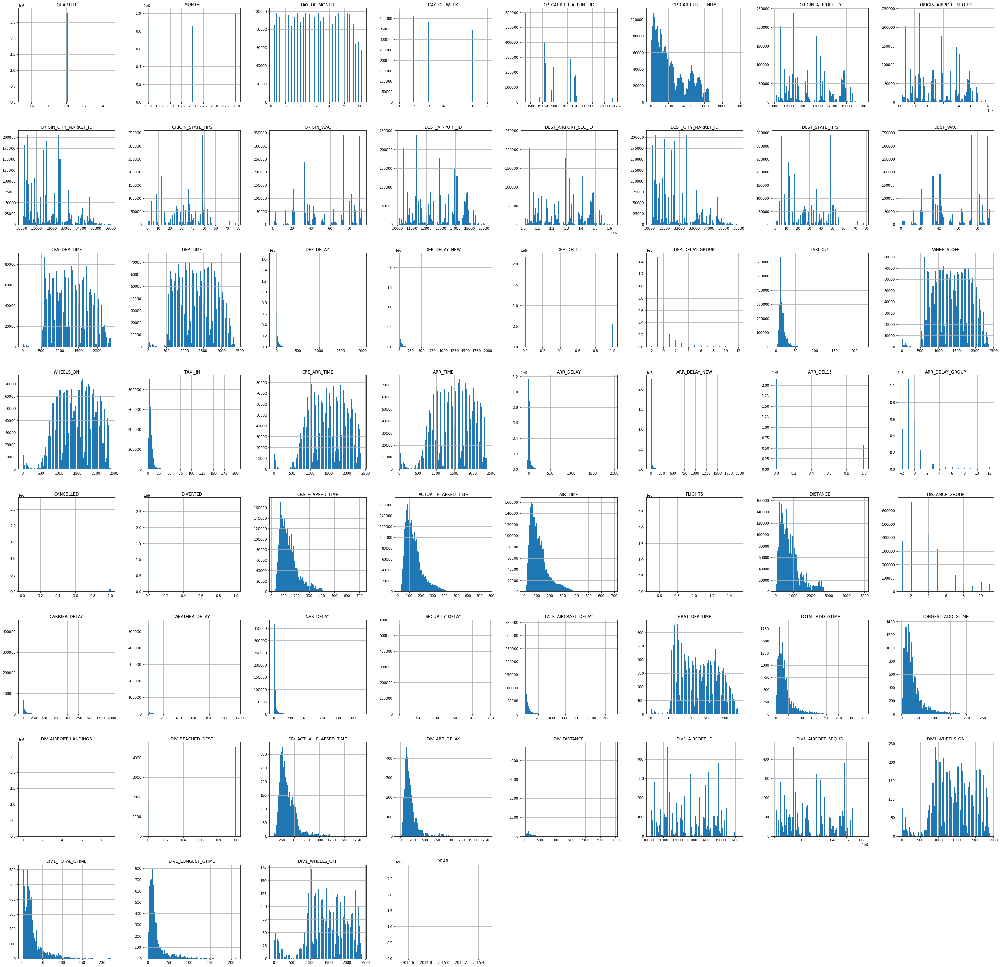

In [0]:
%matplotlib inline
df_airlines_pandas.hist(bins=100, figsize=(50,50))
#save_fig("attribute_histogram_lots")
plt.show()

**General Data Investigation (to inform rest of analysis)**

**Statistics on Delays**

In [0]:
# Take statistics on delays (early departures show negative numbers)
df_airlines.select('DEP_DELAY').describe().show()

+-------+------------------+
summary| DEP_DELAY|
+-------+------------------+
 count| 2722232|
 mean|10.362709717614075|
 stddev| 37.86481540541778|
 min| -61.0|
 max| 1988.0|
+-------+------------------+

**Commentary:** Average delay is 10.36 minutes (early departures bring the average down)

In [0]:
# Take statistics on delays (early departures set to 0)
df_airlines.select('DEP_DELAY_NEW').describe().show()

+-------+------------------+
summary| DEP_DELAY_NEW|
+-------+------------------+
 count| 2722232|
 mean|13.025645867067906|
 stddev| 36.78559074755402|
 min| 0.0|
 max| 1988.0|
+-------+------------------+

Commentary: Average delay is 13.03 minutes (early departures do not count towards the average)

How many flights are delayed? (please note the field "DEP_DEL15" used has 84,710 null records)

In [0]:
spark.sql("SELECT COUNT(DEP_DEL15) AS Number_of_Delayed_Flights FROM airlines WHERE DEP_DEL15=1").display()

Number_of_Delayed_Flights
555702


**What percent of flights are delayed?** (please note the field "DEP_DEL15" used has 84,710 null records)

In [0]:
delayed_flights_df = spark.sql("SELECT COUNT(DEP_DEL15)/(SELECT COUNT(DEP_DEL15) FROM airlines) AS Percent_of_Flights_Delayed FROM airlines WHERE DEP_DEL15=1").display()

Percent_of_Flights_Delayed
0.20413469535293097


**Delays By Airport**

In [0]:
# Starting Locations
delays_by_start = spark.sql("SELECT ORIGIN as starting_point, MEAN(DEP_DEL15) as pct_delayed, count(ORIGIN) as num_occurances FROM airlines WHERE DEP_DEL15 IS NOT NULL GROUP BY ORIGIN ORDER BY pct_delayed DESC")
delays_by_start.display()

starting_point,pct_delayed,num_occurances
ILG,0.4166666666666667,144
UST,0.38461538461538464,78
OTH,0.375,96
GUM,0.36666666666666664,180
TTN,0.3655913978494624,1302
BPT,0.3446808510638298,470
STC,0.32051282051282054,156
PBG,0.3181818181818182,176
ORD,0.30528482175670707,136050
CEC,0.30246913580246915,324


In [0]:
# Ending Locations
delays_by_end = spark.sql("SELECT DEST as destination, MEAN(DEP_DEL15) as pct_delayed, count(DEST) as num_occurances FROM airlines WHERE DEP_DEL15 IS NOT NULL GROUP BY DEST ORDER BY pct_delayed DESC")
delays_by_end.display()

destination,pct_delayed,num_occurances
TTN,0.4123076923076923,1300
MQT,0.39473684210526316,152
ALO,0.39473684210526316,304
SUX,0.3935483870967742,310
COU,0.38392857142857145,672
STC,0.37662337662337664,154
GUM,0.3707865168539326,178
BQN,0.3664383561643836,584
UST,0.36585365853658536,82
DBQ,0.3395348837209302,430


In [0]:
delays_by_end.describe("pct_delayed").show()

+-------+--------------------+
summary| pct_delayed|
+-------+--------------------+
 count| 315|
 mean| 0.2077307510272989|
 stddev| 0.06359937444471495|
 min|0.011235955056179775|
 max| 0.4123076923076923|
+-------+--------------------+

In [0]:
delays_by_start.describe("pct_delayed").show()

+-------+--------------------+
summary| pct_delayed|
+-------+--------------------+
 count| 315|
 mean| 0.17830866623957206|
 stddev|0.059450949992557275|
 min|0.017241379310344827|
 max| 0.4166666666666667|
+-------+--------------------+

**Commentary:** It appears the worst airports have flights delayed around 40% and the best airports have flights delayed around 2% of the time. It also appears that some of the worst airports for departure tend to be the worst airports for arrival. An example would be the Trenton airport (TTN) which ranks in the top 5 for both departing and arriving flights. Because of the wide distribution of delay percentages by airport, we believe that some form of airport identification will be an important feature in our classifier.

**Delay Probability By Time**

In [0]:
# By day of week (1 = MONDAY)
delays_by_weekday = spark.sql("SELECT DAY_OF_WEEK, MEAN(DEP_DEL15) as pct_delayed from airlines WHERE DEP_DEL15 IS NOT NULL group by DAY_OF_WEEK order by DAY_OF_WEEK")
delays_by_weekday.show()

+-----------+-------------------+
DAY_OF_WEEK| pct_delayed|
+-----------+-------------------+
 1|0.23070728031818968|
 2|0.18908266674761826|
 3|0.17600478111459733|
 4|0.20794736893478707|
 5| 0.2121916949892722|
 6|0.18306931104735769|
 7|0.22488076102137078|
+-----------+-------------------+

**Commentary:** When looking at delay percentages by day of week, we don't see large differences day by day. Before running this query, we expected weekends to have the highest probability of delays but to our suprise, Mondays tend to have the highest probability of delay followed by Sundays while Saturdays have the second least probability of delay. Note that in this example, day 1 is Monday and day 7 is Sunday. The delay probability is relatively uniform across all days of the week so we do not anticipate we will be able to extract great signal from this feature.

In [0]:
# By Day of Month
delays_by_day_of_month = spark.sql("SELECT DAY_OF_MONTH, MEAN(DEP_DEL15) as pct_delayed from airlines WHERE DEP_DEL15 IS NOT NULL group by DAY_OF_MONTH order by DAY_OF_MONTH")
delays_by_day_of_month.show()

+------------+-------------------+
DAY_OF_MONTH| pct_delayed|
+------------+-------------------+
 1| 0.2699340488814173|
 2| 0.2970312225925276|
 3| 0.3185135587546033|
 4|0.30650536703601106|
 5| 0.3032702388524554|
 6| 0.2664920016188468|
 7| 0.1834002355599356|
 8|0.19903744725738395|
 9|0.20798091058226986|
 10|0.14246221894581643|
 11|0.16747327439719514|
 12|0.22356930031850406|
 13| 0.1752628426249148|
 14|0.15764947665248769|
 15|0.18151096091422472|
 16|0.19052079430498314|
 17|0.18813971634460916|
 18|0.17089126867605148|
 19|0.16047266270740218|
 20|0.19506110726788672|
+------------+-------------------+
only showing top 20 rows

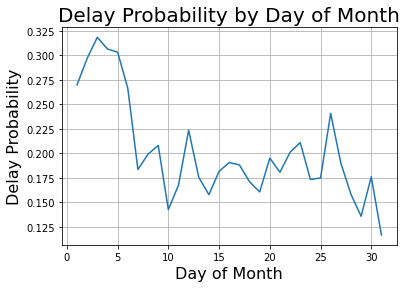

In [0]:
# Plotting by Day of Month
day_of_month = delays_by_day_of_month.toPandas()
x = day_of_month['DAY_OF_MONTH']
y = day_of_month['pct_delayed']
plt.plot(x,y)
plt.title('Delay Probability by Day of Month', fontsize = 20)
plt.xlabel('Day of Month', fontsize = 16)
plt.ylabel('Delay Probability', fontsize = 16)
plt.grid()

**Commentary:** When plotting by days of month we see an interesting and unexpected trend. The first few days of the month have a much higher delay probability than the rest of the month. We hypothesize that this might be because this only includes Q1 data and many travellers were delayed by the New Years Day holiday. We are unsure if this trend will hold up on our larger dataset but we are curious to find out.

In [0]:
# By Time of Day
delays_by_time = spark.sql("SELECT CRS_DEP_TIME, MEAN(DEP_DEL15) as pct_delayed from airlines WHERE DEP_DEL15 IS NOT NULL group by CRS_DEP_TIME order by CRS_DEP_TIME desc")
delays_by_time.show()

+------------+--------------------+
CRS_DEP_TIME| pct_delayed|
+------------+--------------------+
 2359| 0.23229706390328153|
 2358| 0.5263157894736842|
 2357| 0.2616822429906542|
 2356| 0.288135593220339|
 2355| 0.18577648766328012|
 2354| 0.23893805309734514|
 2353| 0.2682926829268293|
 2352| 0.2857142857142857|
 2351| 0.17647058823529413|
 2350| 0.1507293354943274|
 2349| 0.1830065359477124|
 2348| 0.40963855421686746|
 2347| 0.22727272727272727|
 2346| 0.5|
 2345| 0.1111111111111111|
 2344| 0.32432432432432434|
 2343| 0.17857142857142858|
 2342|0.058823529411764705|
 2341| 0.10526315789473684|
 2340| 0.1828978622327791|
+------------+--------------------+
only showing top 20 rows

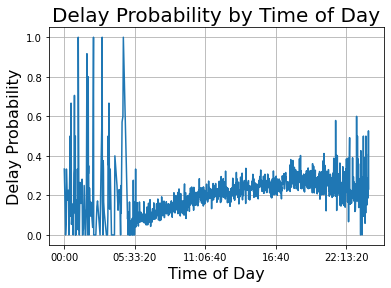

In [0]:
# Creating datetime format for plotting
delay_times = delays_by_time.toPandas()
delay_times['CRS_DEP_TIME'] = delay_times['CRS_DEP_TIME'].astype('str')
delay_times['CRS_DEP_TIME'] = delay_times['CRS_DEP_TIME'].apply(lambda x: x[:-2] + ':' + x[-2:])
delay_times['CRS_DEP_TIME'] = delay_times['CRS_DEP_TIME'].apply(lambda line: '0' + line if (line[0] == ':') else line)
delay_times['CRS_DEP_TIME'] = pd.to_datetime(delay_times['CRS_DEP_TIME'], format = '%H:%M').dt.time

# Defining x and y
x = delay_times['CRS_DEP_TIME']
y = y = delay_times['pct_delayed']

# Ensuring Matplotlib can handle time data on x-axis
pd.plotting.register_matplotlib_converters()

# Plotting by Time of Day
plt.plot(x,y)
plt.title('Delay Probability by Time of Day', fontsize = 20)
plt.xlabel('Time of Day', fontsize = 16)
plt.ylabel('Delay Probability', fontsize = 16)
plt.grid()

**Commentary:** We can see above that delay probability by time of day is quite noise in the early hours of the morning likely because in our 1 quarter sample there are not enough flights so our variance is really high. AS we inrease the amount of data, we expect the variance will decrease. Between about 5am and 10pm there is reasonable variance and we can see that as we get later in the afternoon there is a higher probability that a flight will be delayed. We can see that the delays peak around 5pm. We expect that time of day will be a good feature for our classifier.

In [0]:
# Show columns' percent of data missing
df_airlines_pandas = df_airlines.select("*").toPandas() # Convert Spark dataframe to Pandas dataframe
data_null = df_airlines_pandas.isnull().sum().sort_values(ascending=False)
total_count = df_airlines_pandas.isnull().count()
data_missing_percent = (data_null/total_count*100).sort_values(ascending=False)
data_missing = pd.concat([data_null,data_missing_percent],axis=1,keys=['Data Missing','%'])
data_missing.head(20)

Out[148]:

,Data Missing,%
DIV3_TAIL_NUM,2806942,100.000000
DIV5_AIRPORT,2806942,100.000000
DIV3_WHEELS_OFF,2806942,100.000000
DIV4_AIRPORT,2806942,100.000000
DIV4_AIRPORT_ID,2806942,100.000000
DIV4_AIRPORT_SEQ_ID,2806942,100.000000
DIV4_TOTAL_GTIME,2806942,100.000000
DIV4_LONGEST_GTIME,2806942,100.000000
DIV4_WHEELS_OFF,2806942,100.000000
DIV4_TAIL_NUM,2806942,100.000000


### Step 5: Split Data

In [0]:
# features_df = df_main.drop('DEP_DEL15')
# labels_df = df_main.select('DEP_DEL15') 

# tscv = TimeSeriesSplit()


In [0]:
#creating simple baseline model
df_main = df_main.withColumn('baseline_pred', F.lit(0))
df_main = df_main.withColumn('correct_pred', when(df_main['baseline_pred'] == df_main['DEP_DEL15'], 1)
                                             .otherwise(0))




In [0]:
#calculating success metrics
# total = df_main.count()
# total_correct = df_main.select(sum('correct_pred')).count()

# accuracy = total / total_correct
# act_pos = df_main.select(sum('DEP_DEL15')).collect()
# act_neg = total - act_pos

TP = df_main.filter((df_main['baseline_pred'] == 1) & (df_main['DEP_DEL15'] == 1)).count()
TN = df_main.filter((df_main['baseline_pred'] == 0) & (df_main['DEP_DEL15'] == 0)).count()
FP = df_main.filter((df_main['baseline_pred'] == 1) & (df_main['DEP_DEL15'] == 0)).count()
FN = df_main.filter((df_main['baseline_pred'] == 0) & (df_main['DEP_DEL15'] == 1)).count()

TPR = TP/(TP+FN)
FNR = FN/(TP+FN)
TNR = TN/(TN+FP)
FPR = FP/(TN+FP)

print(f'True Positive Rate = {TPR}')
print(f'False Negative Rate = {FNR}')
print(f'True Negative Rate = {TNR}')
print(f'False Positive Rate = {FPR}')

True Positive Rate = 0.0
False Negative Rate = 1.0
True Negative Rate = 1.0
False Positive Rate = 0.0

In [0]:
print(TP,TN,FP,FN)

0 32715464 0 7104232

In [0]:
#calculating and printing metric results
prec = 'division by zero' #TP / (TP + FP)
recall = TP / (TP +FN)
accuracy = (TP +TN) / (TP+TN+FP+FN)

print(f'The baseline precision was n/a due to no True positive or false positives')
print(f'The baseline recall: {recall}')
print(f'The baseline accuracy: {accuracy}')

The baseline precision was n/a due to no True positive or false positives
The baseline recall: 0.0
The baseline accuracy: 0.8215899990798523